In [5]:
import scanpy as sc
import torch
import scarches as sca
from scarches.dataset.trvae.data_handling import remove_sparsity
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
sc.settings.figdir="/home/gilberthan/Desktop/disk1/limb/3.9_wt_integrate/result/"

In [62]:
adata=sc.read("../../important_processed_data/4.12_wt_integrate_SCRAN_log1p.h5ad")

In [32]:
index=pd.read_csv("../../unimportant_processed_data/4.15_wt_integrate_index.csv",header=None)

In [33]:
index

,0
0,0.0
1,1.0
2,2.0
3,3.0
4,4.0
...,...
273474,274665.0
273475,274666.0
273476,274667.0
273477,274668.0


In [42]:
index_arr=index[0].astype(int)

In [44]:
index_arr[0]

0

In [45]:
np.array(index_arr)

array([     0,      1,      2,      3,      4,      5,      6, ...,
       274663, 274664, 274665, 274666, 274667, 274668, 274669])

In [46]:
adata=adata[index_arr,]

In [52]:
del adata.obsm

In [55]:
nlatent=15
unlabeled = adata.obs.index[[ coarse_label != "Osteoblasts" for coarse_label in adata.obs.coarse_label]]
adata.obs['scanvi_label'] = adata.obs.coarse_label.tolist()
adata.obs.loc[unlabeled,'scanvi_label'] = "unlabeled"

condition_key = 'batch'
cell_type_key = 'scanvi_label'
unlabeled_category = "unlabeled"


# In[7]:



sc.pp.highly_variable_genes(adata, batch_key="batch",min_mean=0.035, flavor="cell_ranger",n_top_genes=1500)
adata = adata[:,adata.var.highly_variable].copy()
adata.X = adata.layers['counts']
adata.raw = adata
raw = adata.raw.to_adata()
raw.X = adata.layers['counts']
adata.raw = raw
sca.models.SCVI.setup_anndata(adata, batch_key=condition_key, labels_key=cell_type_key)
vae = sca.models.SCVI(
    adata,
    n_latent=nlatent,
    encode_covariates=True,
    deeply_inject_covariates=False,
    use_layer_norm="both",
    use_batch_norm="none",
    gene_likelihood="zinb",
    n_layers=1,
    dropout_rate=0.1
    )
vae.train(max_epochs=100)
scanvae = sca.models.SCANVI.from_scvi_model(vae, unlabeled_category =unlabeled_category)
scanvae.train(max_epochs=50)

/home/gilberthan/anaconda3/envs/scarches/lib/python3.8/site-packages/scanpy/preprocessing/_highly_variable_genes.py:478: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  hvg = hvg.append(missing_hvg, ignore_index=True)
/home/gilberthan/anaconda3/envs/scarches/lib/python3.8/site-packages/scanpy/preprocessing/_highly_variable_genes.py:478: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  hvg = hvg.append(missing_hvg, ignore_index=True)
/home/gilberthan/anaconda3/envs/scarches/lib/python3.8/site-packages/scanpy/preprocessing/_highly_variable_genes.py:478: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  hvg = hvg.append(missing_hvg, ignore_index=True)
/home/gilberthan/anaconda3/envs/scarches/lib/python3.8/site-packages/scanpy/preproces

/home/gilberthan/anaconda3/envs/scarches/lib/python3.8/site-packages/scanpy/preprocessing/_highly_variable_genes.py:478: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  hvg = hvg.append(missing_hvg, ignore_index=True)
/home/gilberthan/anaconda3/envs/scarches/lib/python3.8/site-packages/scanpy/preprocessing/_highly_variable_genes.py:478: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  hvg = hvg.append(missing_hvg, ignore_index=True)
/home/gilberthan/anaconda3/envs/scarches/lib/python3.8/site-packages/scanpy/preprocessing/_highly_variable_genes.py:478: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  hvg = hvg.append(missing_hvg, ignore_index=True)
/home/gilberthan/anaconda3/envs/scarches/lib/python3.8/site-packages/scanpy/preproces

/home/gilberthan/anaconda3/envs/scarches/lib/python3.8/site-packages/scanpy/preprocessing/_highly_variable_genes.py:478: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  hvg = hvg.append(missing_hvg, ignore_index=True)
/home/gilberthan/anaconda3/envs/scarches/lib/python3.8/site-packages/scanpy/preprocessing/_highly_variable_genes.py:478: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  hvg = hvg.append(missing_hvg, ignore_index=True)
/home/gilberthan/anaconda3/envs/scarches/lib/python3.8/site-packages/scanpy/preprocessing/_highly_variable_genes.py:478: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  hvg = hvg.append(missing_hvg, ignore_index=True)
/home/gilberthan/anaconda3/envs/scarches/lib/python3.8/site-packages/scanpy/preproces

/home/gilberthan/anaconda3/envs/scarches/lib/python3.8/site-packages/scanpy/preprocessing/_highly_variable_genes.py:478: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  hvg = hvg.append(missing_hvg, ignore_index=True)
/home/gilberthan/anaconda3/envs/scarches/lib/python3.8/site-packages/scanpy/preprocessing/_highly_variable_genes.py:478: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  hvg = hvg.append(missing_hvg, ignore_index=True)
/home/gilberthan/anaconda3/envs/scarches/lib/python3.8/site-packages/scanpy/preprocessing/_highly_variable_genes.py:478: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  hvg = hvg.append(missing_hvg, ignore_index=True)
/home/gilberthan/anaconda3/envs/scarches/lib/python3.8/site-packages/scanpy/preproces

Epoch 1/100:   0%|          | 0/100 [00:00<?, ?it/s]

/home/gilberthan/anaconda3/envs/scarches/lib/python3.8/site-packages/scvi/distributions/_negative_binomial.py:481: UserWarning: The value argument must be within the support of the distribution
  warnings.warn(
/home/gilberthan/anaconda3/envs/scarches/lib/python3.8/site-packages/scvi/distributions/_negative_binomial.py:481: UserWarning: The value argument must be within the support of the distribution
  warnings.warn(


Epoch 2/100:   1%|          | 1/100 [00:44<1:13:03, 44.27s/it, loss=877, v_num=1]

/home/gilberthan/anaconda3/envs/scarches/lib/python3.8/site-packages/scvi/distributions/_negative_binomial.py:481: UserWarning: The value argument must be within the support of the distribution
  warnings.warn(
/home/gilberthan/anaconda3/envs/scarches/lib/python3.8/site-packages/scvi/distributions/_negative_binomial.py:481: UserWarning: The value argument must be within the support of the distribution
  warnings.warn(


Epoch 3/100:   2%|▏         | 2/100 [01:27<1:11:19, 43.67s/it, loss=864, v_num=1]

/home/gilberthan/anaconda3/envs/scarches/lib/python3.8/site-packages/scvi/distributions/_negative_binomial.py:481: UserWarning: The value argument must be within the support of the distribution
  warnings.warn(
/home/gilberthan/anaconda3/envs/scarches/lib/python3.8/site-packages/scvi/distributions/_negative_binomial.py:481: UserWarning: The value argument must be within the support of the distribution
  warnings.warn(


Epoch 4/100:   3%|▎         | 3/100 [02:10<1:10:01, 43.31s/it, loss=857, v_num=1]

/home/gilberthan/anaconda3/envs/scarches/lib/python3.8/site-packages/scvi/distributions/_negative_binomial.py:481: UserWarning: The value argument must be within the support of the distribution
  warnings.warn(
/home/gilberthan/anaconda3/envs/scarches/lib/python3.8/site-packages/scvi/distributions/_negative_binomial.py:481: UserWarning: The value argument must be within the support of the distribution
  warnings.warn(


Epoch 5/100:   4%|▍         | 4/100 [02:53<1:09:08, 43.21s/it, loss=856, v_num=1]

/home/gilberthan/anaconda3/envs/scarches/lib/python3.8/site-packages/scvi/distributions/_negative_binomial.py:481: UserWarning: The value argument must be within the support of the distribution
  warnings.warn(
/home/gilberthan/anaconda3/envs/scarches/lib/python3.8/site-packages/scvi/distributions/_negative_binomial.py:481: UserWarning: The value argument must be within the support of the distribution
  warnings.warn(


Epoch 6/100:   5%|▌         | 5/100 [03:36<1:08:12, 43.08s/it, loss=857, v_num=1]

/home/gilberthan/anaconda3/envs/scarches/lib/python3.8/site-packages/scvi/distributions/_negative_binomial.py:481: UserWarning: The value argument must be within the support of the distribution
  warnings.warn(
/home/gilberthan/anaconda3/envs/scarches/lib/python3.8/site-packages/scvi/distributions/_negative_binomial.py:481: UserWarning: The value argument must be within the support of the distribution
  warnings.warn(


Epoch 7/100:   6%|▌         | 6/100 [04:19<1:07:17, 42.95s/it, loss=847, v_num=1]

/home/gilberthan/anaconda3/envs/scarches/lib/python3.8/site-packages/scvi/distributions/_negative_binomial.py:481: UserWarning: The value argument must be within the support of the distribution
  warnings.warn(
/home/gilberthan/anaconda3/envs/scarches/lib/python3.8/site-packages/scvi/distributions/_negative_binomial.py:481: UserWarning: The value argument must be within the support of the distribution
  warnings.warn(


Epoch 8/100:   7%|▋         | 7/100 [05:01<1:06:29, 42.90s/it, loss=849, v_num=1]

/home/gilberthan/anaconda3/envs/scarches/lib/python3.8/site-packages/scvi/distributions/_negative_binomial.py:481: UserWarning: The value argument must be within the support of the distribution
  warnings.warn(
/home/gilberthan/anaconda3/envs/scarches/lib/python3.8/site-packages/scvi/distributions/_negative_binomial.py:481: UserWarning: The value argument must be within the support of the distribution
  warnings.warn(


Epoch 9/100:   8%|▊         | 8/100 [05:44<1:05:46, 42.90s/it, loss=851, v_num=1]

/home/gilberthan/anaconda3/envs/scarches/lib/python3.8/site-packages/scvi/distributions/_negative_binomial.py:481: UserWarning: The value argument must be within the support of the distribution
  warnings.warn(
/home/gilberthan/anaconda3/envs/scarches/lib/python3.8/site-packages/scvi/distributions/_negative_binomial.py:481: UserWarning: The value argument must be within the support of the distribution
  warnings.warn(


Epoch 10/100:   9%|▉         | 9/100 [06:27<1:05:05, 42.91s/it, loss=847, v_num=1]

/home/gilberthan/anaconda3/envs/scarches/lib/python3.8/site-packages/scvi/distributions/_negative_binomial.py:481: UserWarning: The value argument must be within the support of the distribution
  warnings.warn(
/home/gilberthan/anaconda3/envs/scarches/lib/python3.8/site-packages/scvi/distributions/_negative_binomial.py:481: UserWarning: The value argument must be within the support of the distribution
  warnings.warn(


Epoch 11/100:  10%|█         | 10/100 [07:10<1:04:22, 42.92s/it, loss=852, v_num=1]

/home/gilberthan/anaconda3/envs/scarches/lib/python3.8/site-packages/scvi/distributions/_negative_binomial.py:481: UserWarning: The value argument must be within the support of the distribution
  warnings.warn(
/home/gilberthan/anaconda3/envs/scarches/lib/python3.8/site-packages/scvi/distributions/_negative_binomial.py:481: UserWarning: The value argument must be within the support of the distribution
  warnings.warn(


Epoch 12/100:  11%|█         | 11/100 [07:53<1:03:37, 42.90s/it, loss=848, v_num=1]

/home/gilberthan/anaconda3/envs/scarches/lib/python3.8/site-packages/scvi/distributions/_negative_binomial.py:481: UserWarning: The value argument must be within the support of the distribution
  warnings.warn(
/home/gilberthan/anaconda3/envs/scarches/lib/python3.8/site-packages/scvi/distributions/_negative_binomial.py:481: UserWarning: The value argument must be within the support of the distribution
  warnings.warn(


Epoch 13/100:  12%|█▏        | 12/100 [08:36<1:02:51, 42.86s/it, loss=853, v_num=1]

/home/gilberthan/anaconda3/envs/scarches/lib/python3.8/site-packages/scvi/distributions/_negative_binomial.py:481: UserWarning: The value argument must be within the support of the distribution
  warnings.warn(
/home/gilberthan/anaconda3/envs/scarches/lib/python3.8/site-packages/scvi/distributions/_negative_binomial.py:481: UserWarning: The value argument must be within the support of the distribution
  warnings.warn(


Epoch 14/100:  13%|█▎        | 13/100 [09:19<1:02:07, 42.85s/it, loss=845, v_num=1]

/home/gilberthan/anaconda3/envs/scarches/lib/python3.8/site-packages/scvi/distributions/_negative_binomial.py:481: UserWarning: The value argument must be within the support of the distribution
  warnings.warn(
/home/gilberthan/anaconda3/envs/scarches/lib/python3.8/site-packages/scvi/distributions/_negative_binomial.py:481: UserWarning: The value argument must be within the support of the distribution
  warnings.warn(


Epoch 15/100:  14%|█▍        | 14/100 [10:02<1:01:29, 42.90s/it, loss=849, v_num=1]

/home/gilberthan/anaconda3/envs/scarches/lib/python3.8/site-packages/scvi/distributions/_negative_binomial.py:481: UserWarning: The value argument must be within the support of the distribution
  warnings.warn(
/home/gilberthan/anaconda3/envs/scarches/lib/python3.8/site-packages/scvi/distributions/_negative_binomial.py:481: UserWarning: The value argument must be within the support of the distribution
  warnings.warn(


Epoch 16/100:  15%|█▌        | 15/100 [10:44<1:00:47, 42.91s/it, loss=846, v_num=1]

/home/gilberthan/anaconda3/envs/scarches/lib/python3.8/site-packages/scvi/distributions/_negative_binomial.py:481: UserWarning: The value argument must be within the support of the distribution
  warnings.warn(
/home/gilberthan/anaconda3/envs/scarches/lib/python3.8/site-packages/scvi/distributions/_negative_binomial.py:481: UserWarning: The value argument must be within the support of the distribution
  warnings.warn(


Epoch 17/100:  16%|█▌        | 16/100 [11:28<1:00:14, 43.03s/it, loss=841, v_num=1]

/home/gilberthan/anaconda3/envs/scarches/lib/python3.8/site-packages/scvi/distributions/_negative_binomial.py:481: UserWarning: The value argument must be within the support of the distribution
  warnings.warn(
/home/gilberthan/anaconda3/envs/scarches/lib/python3.8/site-packages/scvi/distributions/_negative_binomial.py:481: UserWarning: The value argument must be within the support of the distribution
  warnings.warn(


Epoch 18/100:  17%|█▋        | 17/100 [12:11<59:30, 43.02s/it, loss=845, v_num=1]  

/home/gilberthan/anaconda3/envs/scarches/lib/python3.8/site-packages/scvi/distributions/_negative_binomial.py:481: UserWarning: The value argument must be within the support of the distribution
  warnings.warn(
/home/gilberthan/anaconda3/envs/scarches/lib/python3.8/site-packages/scvi/distributions/_negative_binomial.py:481: UserWarning: The value argument must be within the support of the distribution
  warnings.warn(


Epoch 19/100:  18%|█▊        | 18/100 [12:54<59:02, 43.20s/it, loss=851, v_num=1]

/home/gilberthan/anaconda3/envs/scarches/lib/python3.8/site-packages/scvi/distributions/_negative_binomial.py:481: UserWarning: The value argument must be within the support of the distribution
  warnings.warn(
/home/gilberthan/anaconda3/envs/scarches/lib/python3.8/site-packages/scvi/distributions/_negative_binomial.py:481: UserWarning: The value argument must be within the support of the distribution
  warnings.warn(


Epoch 20/100:  19%|█▉        | 19/100 [13:38<58:39, 43.45s/it, loss=855, v_num=1]

/home/gilberthan/anaconda3/envs/scarches/lib/python3.8/site-packages/scvi/distributions/_negative_binomial.py:481: UserWarning: The value argument must be within the support of the distribution
  warnings.warn(
/home/gilberthan/anaconda3/envs/scarches/lib/python3.8/site-packages/scvi/distributions/_negative_binomial.py:481: UserWarning: The value argument must be within the support of the distribution
  warnings.warn(


Epoch 21/100:  20%|██        | 20/100 [14:22<58:09, 43.62s/it, loss=847, v_num=1]

/home/gilberthan/anaconda3/envs/scarches/lib/python3.8/site-packages/scvi/distributions/_negative_binomial.py:481: UserWarning: The value argument must be within the support of the distribution
  warnings.warn(
/home/gilberthan/anaconda3/envs/scarches/lib/python3.8/site-packages/scvi/distributions/_negative_binomial.py:481: UserWarning: The value argument must be within the support of the distribution
  warnings.warn(


Epoch 22/100:  21%|██        | 21/100 [15:06<57:26, 43.63s/it, loss=844, v_num=1]

/home/gilberthan/anaconda3/envs/scarches/lib/python3.8/site-packages/scvi/distributions/_negative_binomial.py:481: UserWarning: The value argument must be within the support of the distribution
  warnings.warn(
/home/gilberthan/anaconda3/envs/scarches/lib/python3.8/site-packages/scvi/distributions/_negative_binomial.py:481: UserWarning: The value argument must be within the support of the distribution
  warnings.warn(


Epoch 23/100:  22%|██▏       | 22/100 [15:50<56:50, 43.73s/it, loss=855, v_num=1]

/home/gilberthan/anaconda3/envs/scarches/lib/python3.8/site-packages/scvi/distributions/_negative_binomial.py:481: UserWarning: The value argument must be within the support of the distribution
  warnings.warn(
/home/gilberthan/anaconda3/envs/scarches/lib/python3.8/site-packages/scvi/distributions/_negative_binomial.py:481: UserWarning: The value argument must be within the support of the distribution
  warnings.warn(


Epoch 24/100:  23%|██▎       | 23/100 [16:34<56:11, 43.78s/it, loss=841, v_num=1]

/home/gilberthan/anaconda3/envs/scarches/lib/python3.8/site-packages/scvi/distributions/_negative_binomial.py:481: UserWarning: The value argument must be within the support of the distribution
  warnings.warn(
/home/gilberthan/anaconda3/envs/scarches/lib/python3.8/site-packages/scvi/distributions/_negative_binomial.py:481: UserWarning: The value argument must be within the support of the distribution
  warnings.warn(


Epoch 25/100:  24%|██▍       | 24/100 [17:18<55:27, 43.79s/it, loss=841, v_num=1]

/home/gilberthan/anaconda3/envs/scarches/lib/python3.8/site-packages/scvi/distributions/_negative_binomial.py:481: UserWarning: The value argument must be within the support of the distribution
  warnings.warn(
/home/gilberthan/anaconda3/envs/scarches/lib/python3.8/site-packages/scvi/distributions/_negative_binomial.py:481: UserWarning: The value argument must be within the support of the distribution
  warnings.warn(


Epoch 26/100:  25%|██▌       | 25/100 [18:02<54:52, 43.89s/it, loss=847, v_num=1]

/home/gilberthan/anaconda3/envs/scarches/lib/python3.8/site-packages/scvi/distributions/_negative_binomial.py:481: UserWarning: The value argument must be within the support of the distribution
  warnings.warn(
/home/gilberthan/anaconda3/envs/scarches/lib/python3.8/site-packages/scvi/distributions/_negative_binomial.py:481: UserWarning: The value argument must be within the support of the distribution
  warnings.warn(


Epoch 27/100:  26%|██▌       | 26/100 [18:46<54:16, 44.01s/it, loss=849, v_num=1]

/home/gilberthan/anaconda3/envs/scarches/lib/python3.8/site-packages/scvi/distributions/_negative_binomial.py:481: UserWarning: The value argument must be within the support of the distribution
  warnings.warn(
/home/gilberthan/anaconda3/envs/scarches/lib/python3.8/site-packages/scvi/distributions/_negative_binomial.py:481: UserWarning: The value argument must be within the support of the distribution
  warnings.warn(


Epoch 28/100:  27%|██▋       | 27/100 [19:30<53:29, 43.97s/it, loss=852, v_num=1]

/home/gilberthan/anaconda3/envs/scarches/lib/python3.8/site-packages/scvi/distributions/_negative_binomial.py:481: UserWarning: The value argument must be within the support of the distribution
  warnings.warn(
/home/gilberthan/anaconda3/envs/scarches/lib/python3.8/site-packages/scvi/distributions/_negative_binomial.py:481: UserWarning: The value argument must be within the support of the distribution
  warnings.warn(


Epoch 29/100:  28%|██▊       | 28/100 [20:14<52:42, 43.92s/it, loss=845, v_num=1]

/home/gilberthan/anaconda3/envs/scarches/lib/python3.8/site-packages/scvi/distributions/_negative_binomial.py:481: UserWarning: The value argument must be within the support of the distribution
  warnings.warn(
/home/gilberthan/anaconda3/envs/scarches/lib/python3.8/site-packages/scvi/distributions/_negative_binomial.py:481: UserWarning: The value argument must be within the support of the distribution
  warnings.warn(


Epoch 30/100:  29%|██▉       | 29/100 [20:58<52:01, 43.96s/it, loss=838, v_num=1]

/home/gilberthan/anaconda3/envs/scarches/lib/python3.8/site-packages/scvi/distributions/_negative_binomial.py:481: UserWarning: The value argument must be within the support of the distribution
  warnings.warn(
/home/gilberthan/anaconda3/envs/scarches/lib/python3.8/site-packages/scvi/distributions/_negative_binomial.py:481: UserWarning: The value argument must be within the support of the distribution
  warnings.warn(


Epoch 31/100:  30%|███       | 30/100 [21:43<51:42, 44.31s/it, loss=840, v_num=1]

/home/gilberthan/anaconda3/envs/scarches/lib/python3.8/site-packages/scvi/distributions/_negative_binomial.py:481: UserWarning: The value argument must be within the support of the distribution
  warnings.warn(
/home/gilberthan/anaconda3/envs/scarches/lib/python3.8/site-packages/scvi/distributions/_negative_binomial.py:481: UserWarning: The value argument must be within the support of the distribution
  warnings.warn(


Epoch 32/100:  31%|███       | 31/100 [22:28<51:05, 44.43s/it, loss=836, v_num=1]

/home/gilberthan/anaconda3/envs/scarches/lib/python3.8/site-packages/scvi/distributions/_negative_binomial.py:481: UserWarning: The value argument must be within the support of the distribution
  warnings.warn(
/home/gilberthan/anaconda3/envs/scarches/lib/python3.8/site-packages/scvi/distributions/_negative_binomial.py:481: UserWarning: The value argument must be within the support of the distribution
  warnings.warn(


Epoch 33/100:  32%|███▏      | 32/100 [23:12<50:11, 44.29s/it, loss=845, v_num=1]

/home/gilberthan/anaconda3/envs/scarches/lib/python3.8/site-packages/scvi/distributions/_negative_binomial.py:481: UserWarning: The value argument must be within the support of the distribution
  warnings.warn(
/home/gilberthan/anaconda3/envs/scarches/lib/python3.8/site-packages/scvi/distributions/_negative_binomial.py:481: UserWarning: The value argument must be within the support of the distribution
  warnings.warn(


Epoch 34/100:  33%|███▎      | 33/100 [23:56<49:17, 44.13s/it, loss=843, v_num=1]

/home/gilberthan/anaconda3/envs/scarches/lib/python3.8/site-packages/scvi/distributions/_negative_binomial.py:481: UserWarning: The value argument must be within the support of the distribution
  warnings.warn(
/home/gilberthan/anaconda3/envs/scarches/lib/python3.8/site-packages/scvi/distributions/_negative_binomial.py:481: UserWarning: The value argument must be within the support of the distribution
  warnings.warn(


Epoch 35/100:  34%|███▍      | 34/100 [24:40<48:33, 44.15s/it, loss=847, v_num=1]

/home/gilberthan/anaconda3/envs/scarches/lib/python3.8/site-packages/scvi/distributions/_negative_binomial.py:481: UserWarning: The value argument must be within the support of the distribution
  warnings.warn(
/home/gilberthan/anaconda3/envs/scarches/lib/python3.8/site-packages/scvi/distributions/_negative_binomial.py:481: UserWarning: The value argument must be within the support of the distribution
  warnings.warn(


Epoch 36/100:  35%|███▌      | 35/100 [25:24<47:51, 44.18s/it, loss=842, v_num=1]

/home/gilberthan/anaconda3/envs/scarches/lib/python3.8/site-packages/scvi/distributions/_negative_binomial.py:481: UserWarning: The value argument must be within the support of the distribution
  warnings.warn(
/home/gilberthan/anaconda3/envs/scarches/lib/python3.8/site-packages/scvi/distributions/_negative_binomial.py:481: UserWarning: The value argument must be within the support of the distribution
  warnings.warn(


Epoch 37/100:  36%|███▌      | 36/100 [26:08<47:01, 44.08s/it, loss=841, v_num=1]

/home/gilberthan/anaconda3/envs/scarches/lib/python3.8/site-packages/scvi/distributions/_negative_binomial.py:481: UserWarning: The value argument must be within the support of the distribution
  warnings.warn(
/home/gilberthan/anaconda3/envs/scarches/lib/python3.8/site-packages/scvi/distributions/_negative_binomial.py:481: UserWarning: The value argument must be within the support of the distribution
  warnings.warn(


Epoch 38/100:  37%|███▋      | 37/100 [26:51<46:03, 43.86s/it, loss=839, v_num=1]

/home/gilberthan/anaconda3/envs/scarches/lib/python3.8/site-packages/scvi/distributions/_negative_binomial.py:481: UserWarning: The value argument must be within the support of the distribution
  warnings.warn(
/home/gilberthan/anaconda3/envs/scarches/lib/python3.8/site-packages/scvi/distributions/_negative_binomial.py:481: UserWarning: The value argument must be within the support of the distribution
  warnings.warn(


Epoch 39/100:  38%|███▊      | 38/100 [27:34<45:03, 43.60s/it, loss=847, v_num=1]

/home/gilberthan/anaconda3/envs/scarches/lib/python3.8/site-packages/scvi/distributions/_negative_binomial.py:481: UserWarning: The value argument must be within the support of the distribution
  warnings.warn(
/home/gilberthan/anaconda3/envs/scarches/lib/python3.8/site-packages/scvi/distributions/_negative_binomial.py:481: UserWarning: The value argument must be within the support of the distribution
  warnings.warn(


Epoch 40/100:  39%|███▉      | 39/100 [28:17<44:09, 43.44s/it, loss=839, v_num=1]

/home/gilberthan/anaconda3/envs/scarches/lib/python3.8/site-packages/scvi/distributions/_negative_binomial.py:481: UserWarning: The value argument must be within the support of the distribution
  warnings.warn(
/home/gilberthan/anaconda3/envs/scarches/lib/python3.8/site-packages/scvi/distributions/_negative_binomial.py:481: UserWarning: The value argument must be within the support of the distribution
  warnings.warn(


Epoch 41/100:  40%|████      | 40/100 [29:00<43:20, 43.35s/it, loss=849, v_num=1]

/home/gilberthan/anaconda3/envs/scarches/lib/python3.8/site-packages/scvi/distributions/_negative_binomial.py:481: UserWarning: The value argument must be within the support of the distribution
  warnings.warn(
/home/gilberthan/anaconda3/envs/scarches/lib/python3.8/site-packages/scvi/distributions/_negative_binomial.py:481: UserWarning: The value argument must be within the support of the distribution
  warnings.warn(


Epoch 42/100:  41%|████      | 41/100 [29:43<42:31, 43.25s/it, loss=848, v_num=1]

/home/gilberthan/anaconda3/envs/scarches/lib/python3.8/site-packages/scvi/distributions/_negative_binomial.py:481: UserWarning: The value argument must be within the support of the distribution
  warnings.warn(
/home/gilberthan/anaconda3/envs/scarches/lib/python3.8/site-packages/scvi/distributions/_negative_binomial.py:481: UserWarning: The value argument must be within the support of the distribution
  warnings.warn(


Epoch 43/100:  42%|████▏     | 42/100 [30:27<41:51, 43.30s/it, loss=847, v_num=1]

/home/gilberthan/anaconda3/envs/scarches/lib/python3.8/site-packages/scvi/distributions/_negative_binomial.py:481: UserWarning: The value argument must be within the support of the distribution
  warnings.warn(
/home/gilberthan/anaconda3/envs/scarches/lib/python3.8/site-packages/scvi/distributions/_negative_binomial.py:481: UserWarning: The value argument must be within the support of the distribution
  warnings.warn(


Epoch 44/100:  43%|████▎     | 43/100 [31:10<41:08, 43.30s/it, loss=837, v_num=1]

/home/gilberthan/anaconda3/envs/scarches/lib/python3.8/site-packages/scvi/distributions/_negative_binomial.py:481: UserWarning: The value argument must be within the support of the distribution
  warnings.warn(
/home/gilberthan/anaconda3/envs/scarches/lib/python3.8/site-packages/scvi/distributions/_negative_binomial.py:481: UserWarning: The value argument must be within the support of the distribution
  warnings.warn(


Epoch 45/100:  44%|████▍     | 44/100 [31:53<40:24, 43.30s/it, loss=862, v_num=1]

/home/gilberthan/anaconda3/envs/scarches/lib/python3.8/site-packages/scvi/distributions/_negative_binomial.py:481: UserWarning: The value argument must be within the support of the distribution
  warnings.warn(
/home/gilberthan/anaconda3/envs/scarches/lib/python3.8/site-packages/scvi/distributions/_negative_binomial.py:481: UserWarning: The value argument must be within the support of the distribution
  warnings.warn(


Epoch 46/100:  45%|████▌     | 45/100 [32:36<39:38, 43.25s/it, loss=842, v_num=1]

/home/gilberthan/anaconda3/envs/scarches/lib/python3.8/site-packages/scvi/distributions/_negative_binomial.py:481: UserWarning: The value argument must be within the support of the distribution
  warnings.warn(
/home/gilberthan/anaconda3/envs/scarches/lib/python3.8/site-packages/scvi/distributions/_negative_binomial.py:481: UserWarning: The value argument must be within the support of the distribution
  warnings.warn(


Epoch 47/100:  46%|████▌     | 46/100 [33:19<38:50, 43.16s/it, loss=841, v_num=1]

/home/gilberthan/anaconda3/envs/scarches/lib/python3.8/site-packages/scvi/distributions/_negative_binomial.py:481: UserWarning: The value argument must be within the support of the distribution
  warnings.warn(
/home/gilberthan/anaconda3/envs/scarches/lib/python3.8/site-packages/scvi/distributions/_negative_binomial.py:481: UserWarning: The value argument must be within the support of the distribution
  warnings.warn(


Epoch 48/100:  47%|████▋     | 47/100 [34:03<38:07, 43.16s/it, loss=841, v_num=1]

/home/gilberthan/anaconda3/envs/scarches/lib/python3.8/site-packages/scvi/distributions/_negative_binomial.py:481: UserWarning: The value argument must be within the support of the distribution
  warnings.warn(
/home/gilberthan/anaconda3/envs/scarches/lib/python3.8/site-packages/scvi/distributions/_negative_binomial.py:481: UserWarning: The value argument must be within the support of the distribution
  warnings.warn(


Epoch 49/100:  48%|████▊     | 48/100 [34:46<37:23, 43.15s/it, loss=846, v_num=1]

/home/gilberthan/anaconda3/envs/scarches/lib/python3.8/site-packages/scvi/distributions/_negative_binomial.py:481: UserWarning: The value argument must be within the support of the distribution
  warnings.warn(
/home/gilberthan/anaconda3/envs/scarches/lib/python3.8/site-packages/scvi/distributions/_negative_binomial.py:481: UserWarning: The value argument must be within the support of the distribution
  warnings.warn(


Epoch 50/100:  49%|████▉     | 49/100 [35:29<36:38, 43.11s/it, loss=852, v_num=1]

/home/gilberthan/anaconda3/envs/scarches/lib/python3.8/site-packages/scvi/distributions/_negative_binomial.py:481: UserWarning: The value argument must be within the support of the distribution
  warnings.warn(
/home/gilberthan/anaconda3/envs/scarches/lib/python3.8/site-packages/scvi/distributions/_negative_binomial.py:481: UserWarning: The value argument must be within the support of the distribution
  warnings.warn(


Epoch 51/100:  50%|█████     | 50/100 [36:12<35:56, 43.14s/it, loss=846, v_num=1]

/home/gilberthan/anaconda3/envs/scarches/lib/python3.8/site-packages/scvi/distributions/_negative_binomial.py:481: UserWarning: The value argument must be within the support of the distribution
  warnings.warn(
/home/gilberthan/anaconda3/envs/scarches/lib/python3.8/site-packages/scvi/distributions/_negative_binomial.py:481: UserWarning: The value argument must be within the support of the distribution
  warnings.warn(


Epoch 52/100:  51%|█████     | 51/100 [36:55<35:12, 43.12s/it, loss=854, v_num=1]

/home/gilberthan/anaconda3/envs/scarches/lib/python3.8/site-packages/scvi/distributions/_negative_binomial.py:481: UserWarning: The value argument must be within the support of the distribution
  warnings.warn(
/home/gilberthan/anaconda3/envs/scarches/lib/python3.8/site-packages/scvi/distributions/_negative_binomial.py:481: UserWarning: The value argument must be within the support of the distribution
  warnings.warn(


Epoch 53/100:  52%|█████▏    | 52/100 [37:38<34:32, 43.17s/it, loss=846, v_num=1]

/home/gilberthan/anaconda3/envs/scarches/lib/python3.8/site-packages/scvi/distributions/_negative_binomial.py:481: UserWarning: The value argument must be within the support of the distribution
  warnings.warn(
/home/gilberthan/anaconda3/envs/scarches/lib/python3.8/site-packages/scvi/distributions/_negative_binomial.py:481: UserWarning: The value argument must be within the support of the distribution
  warnings.warn(


Epoch 54/100:  53%|█████▎    | 53/100 [38:21<33:48, 43.17s/it, loss=838, v_num=1]

/home/gilberthan/anaconda3/envs/scarches/lib/python3.8/site-packages/scvi/distributions/_negative_binomial.py:481: UserWarning: The value argument must be within the support of the distribution
  warnings.warn(
/home/gilberthan/anaconda3/envs/scarches/lib/python3.8/site-packages/scvi/distributions/_negative_binomial.py:481: UserWarning: The value argument must be within the support of the distribution
  warnings.warn(


Epoch 55/100:  54%|█████▍    | 54/100 [39:05<33:05, 43.17s/it, loss=835, v_num=1]

/home/gilberthan/anaconda3/envs/scarches/lib/python3.8/site-packages/scvi/distributions/_negative_binomial.py:481: UserWarning: The value argument must be within the support of the distribution
  warnings.warn(
/home/gilberthan/anaconda3/envs/scarches/lib/python3.8/site-packages/scvi/distributions/_negative_binomial.py:481: UserWarning: The value argument must be within the support of the distribution
  warnings.warn(


Epoch 56/100:  55%|█████▌    | 55/100 [39:48<32:20, 43.12s/it, loss=846, v_num=1]

/home/gilberthan/anaconda3/envs/scarches/lib/python3.8/site-packages/scvi/distributions/_negative_binomial.py:481: UserWarning: The value argument must be within the support of the distribution
  warnings.warn(
/home/gilberthan/anaconda3/envs/scarches/lib/python3.8/site-packages/scvi/distributions/_negative_binomial.py:481: UserWarning: The value argument must be within the support of the distribution
  warnings.warn(


Epoch 57/100:  56%|█████▌    | 56/100 [40:31<31:34, 43.05s/it, loss=850, v_num=1]

/home/gilberthan/anaconda3/envs/scarches/lib/python3.8/site-packages/scvi/distributions/_negative_binomial.py:481: UserWarning: The value argument must be within the support of the distribution
  warnings.warn(
/home/gilberthan/anaconda3/envs/scarches/lib/python3.8/site-packages/scvi/distributions/_negative_binomial.py:481: UserWarning: The value argument must be within the support of the distribution
  warnings.warn(


Epoch 58/100:  57%|█████▋    | 57/100 [41:14<30:51, 43.07s/it, loss=847, v_num=1]

/home/gilberthan/anaconda3/envs/scarches/lib/python3.8/site-packages/scvi/distributions/_negative_binomial.py:481: UserWarning: The value argument must be within the support of the distribution
  warnings.warn(
/home/gilberthan/anaconda3/envs/scarches/lib/python3.8/site-packages/scvi/distributions/_negative_binomial.py:481: UserWarning: The value argument must be within the support of the distribution
  warnings.warn(


Epoch 59/100:  58%|█████▊    | 58/100 [41:57<30:07, 43.04s/it, loss=852, v_num=1]

/home/gilberthan/anaconda3/envs/scarches/lib/python3.8/site-packages/scvi/distributions/_negative_binomial.py:481: UserWarning: The value argument must be within the support of the distribution
  warnings.warn(
/home/gilberthan/anaconda3/envs/scarches/lib/python3.8/site-packages/scvi/distributions/_negative_binomial.py:481: UserWarning: The value argument must be within the support of the distribution
  warnings.warn(


Epoch 60/100:  59%|█████▉    | 59/100 [42:40<29:23, 43.01s/it, loss=842, v_num=1]

/home/gilberthan/anaconda3/envs/scarches/lib/python3.8/site-packages/scvi/distributions/_negative_binomial.py:481: UserWarning: The value argument must be within the support of the distribution
  warnings.warn(
/home/gilberthan/anaconda3/envs/scarches/lib/python3.8/site-packages/scvi/distributions/_negative_binomial.py:481: UserWarning: The value argument must be within the support of the distribution
  warnings.warn(


Epoch 61/100:  60%|██████    | 60/100 [43:23<28:43, 43.08s/it, loss=858, v_num=1]

/home/gilberthan/anaconda3/envs/scarches/lib/python3.8/site-packages/scvi/distributions/_negative_binomial.py:481: UserWarning: The value argument must be within the support of the distribution
  warnings.warn(
/home/gilberthan/anaconda3/envs/scarches/lib/python3.8/site-packages/scvi/distributions/_negative_binomial.py:481: UserWarning: The value argument must be within the support of the distribution
  warnings.warn(


Epoch 62/100:  61%|██████    | 61/100 [44:06<28:05, 43.23s/it, loss=845, v_num=1]

/home/gilberthan/anaconda3/envs/scarches/lib/python3.8/site-packages/scvi/distributions/_negative_binomial.py:481: UserWarning: The value argument must be within the support of the distribution
  warnings.warn(
/home/gilberthan/anaconda3/envs/scarches/lib/python3.8/site-packages/scvi/distributions/_negative_binomial.py:481: UserWarning: The value argument must be within the support of the distribution
  warnings.warn(


Epoch 63/100:  62%|██████▏   | 62/100 [44:49<27:20, 43.17s/it, loss=855, v_num=1]

/home/gilberthan/anaconda3/envs/scarches/lib/python3.8/site-packages/scvi/distributions/_negative_binomial.py:481: UserWarning: The value argument must be within the support of the distribution
  warnings.warn(
/home/gilberthan/anaconda3/envs/scarches/lib/python3.8/site-packages/scvi/distributions/_negative_binomial.py:481: UserWarning: The value argument must be within the support of the distribution
  warnings.warn(


Epoch 64/100:  63%|██████▎   | 63/100 [45:32<26:32, 43.03s/it, loss=850, v_num=1]

/home/gilberthan/anaconda3/envs/scarches/lib/python3.8/site-packages/scvi/distributions/_negative_binomial.py:481: UserWarning: The value argument must be within the support of the distribution
  warnings.warn(
/home/gilberthan/anaconda3/envs/scarches/lib/python3.8/site-packages/scvi/distributions/_negative_binomial.py:481: UserWarning: The value argument must be within the support of the distribution
  warnings.warn(


Epoch 65/100:  64%|██████▍   | 64/100 [46:15<25:50, 43.06s/it, loss=844, v_num=1]

/home/gilberthan/anaconda3/envs/scarches/lib/python3.8/site-packages/scvi/distributions/_negative_binomial.py:481: UserWarning: The value argument must be within the support of the distribution
  warnings.warn(
/home/gilberthan/anaconda3/envs/scarches/lib/python3.8/site-packages/scvi/distributions/_negative_binomial.py:481: UserWarning: The value argument must be within the support of the distribution
  warnings.warn(


Epoch 66/100:  65%|██████▌   | 65/100 [46:58<25:05, 43.00s/it, loss=858, v_num=1]

/home/gilberthan/anaconda3/envs/scarches/lib/python3.8/site-packages/scvi/distributions/_negative_binomial.py:481: UserWarning: The value argument must be within the support of the distribution
  warnings.warn(
/home/gilberthan/anaconda3/envs/scarches/lib/python3.8/site-packages/scvi/distributions/_negative_binomial.py:481: UserWarning: The value argument must be within the support of the distribution
  warnings.warn(


Epoch 67/100:  66%|██████▌   | 66/100 [47:41<24:22, 43.02s/it, loss=844, v_num=1]

/home/gilberthan/anaconda3/envs/scarches/lib/python3.8/site-packages/scvi/distributions/_negative_binomial.py:481: UserWarning: The value argument must be within the support of the distribution
  warnings.warn(
/home/gilberthan/anaconda3/envs/scarches/lib/python3.8/site-packages/scvi/distributions/_negative_binomial.py:481: UserWarning: The value argument must be within the support of the distribution
  warnings.warn(


Epoch 68/100:  67%|██████▋   | 67/100 [48:24<23:42, 43.10s/it, loss=840, v_num=1]

/home/gilberthan/anaconda3/envs/scarches/lib/python3.8/site-packages/scvi/distributions/_negative_binomial.py:481: UserWarning: The value argument must be within the support of the distribution
  warnings.warn(
/home/gilberthan/anaconda3/envs/scarches/lib/python3.8/site-packages/scvi/distributions/_negative_binomial.py:481: UserWarning: The value argument must be within the support of the distribution
  warnings.warn(


Epoch 69/100:  68%|██████▊   | 68/100 [49:07<22:56, 43.00s/it, loss=846, v_num=1]

/home/gilberthan/anaconda3/envs/scarches/lib/python3.8/site-packages/scvi/distributions/_negative_binomial.py:481: UserWarning: The value argument must be within the support of the distribution
  warnings.warn(
/home/gilberthan/anaconda3/envs/scarches/lib/python3.8/site-packages/scvi/distributions/_negative_binomial.py:481: UserWarning: The value argument must be within the support of the distribution
  warnings.warn(


Epoch 70/100:  69%|██████▉   | 69/100 [49:50<22:12, 43.00s/it, loss=849, v_num=1]

/home/gilberthan/anaconda3/envs/scarches/lib/python3.8/site-packages/scvi/distributions/_negative_binomial.py:481: UserWarning: The value argument must be within the support of the distribution
  warnings.warn(
/home/gilberthan/anaconda3/envs/scarches/lib/python3.8/site-packages/scvi/distributions/_negative_binomial.py:481: UserWarning: The value argument must be within the support of the distribution
  warnings.warn(


Epoch 71/100:  70%|███████   | 70/100 [50:33<21:29, 43.00s/it, loss=847, v_num=1]

/home/gilberthan/anaconda3/envs/scarches/lib/python3.8/site-packages/scvi/distributions/_negative_binomial.py:481: UserWarning: The value argument must be within the support of the distribution
  warnings.warn(
/home/gilberthan/anaconda3/envs/scarches/lib/python3.8/site-packages/scvi/distributions/_negative_binomial.py:481: UserWarning: The value argument must be within the support of the distribution
  warnings.warn(


Epoch 72/100:  71%|███████   | 71/100 [51:16<20:47, 43.01s/it, loss=845, v_num=1]

/home/gilberthan/anaconda3/envs/scarches/lib/python3.8/site-packages/scvi/distributions/_negative_binomial.py:481: UserWarning: The value argument must be within the support of the distribution
  warnings.warn(
/home/gilberthan/anaconda3/envs/scarches/lib/python3.8/site-packages/scvi/distributions/_negative_binomial.py:481: UserWarning: The value argument must be within the support of the distribution
  warnings.warn(


Epoch 73/100:  72%|███████▏  | 72/100 [51:59<20:05, 43.04s/it, loss=863, v_num=1]

/home/gilberthan/anaconda3/envs/scarches/lib/python3.8/site-packages/scvi/distributions/_negative_binomial.py:481: UserWarning: The value argument must be within the support of the distribution
  warnings.warn(
/home/gilberthan/anaconda3/envs/scarches/lib/python3.8/site-packages/scvi/distributions/_negative_binomial.py:481: UserWarning: The value argument must be within the support of the distribution
  warnings.warn(


Epoch 74/100:  73%|███████▎  | 73/100 [52:43<19:24, 43.12s/it, loss=844, v_num=1]

/home/gilberthan/anaconda3/envs/scarches/lib/python3.8/site-packages/scvi/distributions/_negative_binomial.py:481: UserWarning: The value argument must be within the support of the distribution
  warnings.warn(
/home/gilberthan/anaconda3/envs/scarches/lib/python3.8/site-packages/scvi/distributions/_negative_binomial.py:481: UserWarning: The value argument must be within the support of the distribution
  warnings.warn(


Epoch 75/100:  74%|███████▍  | 74/100 [53:26<18:44, 43.25s/it, loss=852, v_num=1]

/home/gilberthan/anaconda3/envs/scarches/lib/python3.8/site-packages/scvi/distributions/_negative_binomial.py:481: UserWarning: The value argument must be within the support of the distribution
  warnings.warn(
/home/gilberthan/anaconda3/envs/scarches/lib/python3.8/site-packages/scvi/distributions/_negative_binomial.py:481: UserWarning: The value argument must be within the support of the distribution
  warnings.warn(


Epoch 76/100:  75%|███████▌  | 75/100 [54:09<17:57, 43.12s/it, loss=840, v_num=1]

/home/gilberthan/anaconda3/envs/scarches/lib/python3.8/site-packages/scvi/distributions/_negative_binomial.py:481: UserWarning: The value argument must be within the support of the distribution
  warnings.warn(
/home/gilberthan/anaconda3/envs/scarches/lib/python3.8/site-packages/scvi/distributions/_negative_binomial.py:481: UserWarning: The value argument must be within the support of the distribution
  warnings.warn(


Epoch 77/100:  76%|███████▌  | 76/100 [54:52<17:15, 43.13s/it, loss=859, v_num=1]

/home/gilberthan/anaconda3/envs/scarches/lib/python3.8/site-packages/scvi/distributions/_negative_binomial.py:481: UserWarning: The value argument must be within the support of the distribution
  warnings.warn(
/home/gilberthan/anaconda3/envs/scarches/lib/python3.8/site-packages/scvi/distributions/_negative_binomial.py:481: UserWarning: The value argument must be within the support of the distribution
  warnings.warn(


Epoch 78/100:  77%|███████▋  | 77/100 [55:35<16:31, 43.13s/it, loss=859, v_num=1]

/home/gilberthan/anaconda3/envs/scarches/lib/python3.8/site-packages/scvi/distributions/_negative_binomial.py:481: UserWarning: The value argument must be within the support of the distribution
  warnings.warn(
/home/gilberthan/anaconda3/envs/scarches/lib/python3.8/site-packages/scvi/distributions/_negative_binomial.py:481: UserWarning: The value argument must be within the support of the distribution
  warnings.warn(


Epoch 79/100:  78%|███████▊  | 78/100 [56:18<15:48, 43.10s/it, loss=835, v_num=1]

/home/gilberthan/anaconda3/envs/scarches/lib/python3.8/site-packages/scvi/distributions/_negative_binomial.py:481: UserWarning: The value argument must be within the support of the distribution
  warnings.warn(
/home/gilberthan/anaconda3/envs/scarches/lib/python3.8/site-packages/scvi/distributions/_negative_binomial.py:481: UserWarning: The value argument must be within the support of the distribution
  warnings.warn(


Epoch 80/100:  79%|███████▉  | 79/100 [57:02<15:05, 43.13s/it, loss=845, v_num=1]

/home/gilberthan/anaconda3/envs/scarches/lib/python3.8/site-packages/scvi/distributions/_negative_binomial.py:481: UserWarning: The value argument must be within the support of the distribution
  warnings.warn(
/home/gilberthan/anaconda3/envs/scarches/lib/python3.8/site-packages/scvi/distributions/_negative_binomial.py:481: UserWarning: The value argument must be within the support of the distribution
  warnings.warn(


Epoch 81/100:  80%|████████  | 80/100 [57:45<14:23, 43.17s/it, loss=829, v_num=1]

/home/gilberthan/anaconda3/envs/scarches/lib/python3.8/site-packages/scvi/distributions/_negative_binomial.py:481: UserWarning: The value argument must be within the support of the distribution
  warnings.warn(
/home/gilberthan/anaconda3/envs/scarches/lib/python3.8/site-packages/scvi/distributions/_negative_binomial.py:481: UserWarning: The value argument must be within the support of the distribution
  warnings.warn(


Epoch 82/100:  81%|████████  | 81/100 [58:28<13:40, 43.19s/it, loss=855, v_num=1]

/home/gilberthan/anaconda3/envs/scarches/lib/python3.8/site-packages/scvi/distributions/_negative_binomial.py:481: UserWarning: The value argument must be within the support of the distribution
  warnings.warn(
/home/gilberthan/anaconda3/envs/scarches/lib/python3.8/site-packages/scvi/distributions/_negative_binomial.py:481: UserWarning: The value argument must be within the support of the distribution
  warnings.warn(


Epoch 83/100:  82%|████████▏ | 82/100 [59:11<12:58, 43.23s/it, loss=854, v_num=1]

/home/gilberthan/anaconda3/envs/scarches/lib/python3.8/site-packages/scvi/distributions/_negative_binomial.py:481: UserWarning: The value argument must be within the support of the distribution
  warnings.warn(
/home/gilberthan/anaconda3/envs/scarches/lib/python3.8/site-packages/scvi/distributions/_negative_binomial.py:481: UserWarning: The value argument must be within the support of the distribution
  warnings.warn(


Epoch 84/100:  83%|████████▎ | 83/100 [59:55<12:15, 43.26s/it, loss=853, v_num=1]

/home/gilberthan/anaconda3/envs/scarches/lib/python3.8/site-packages/scvi/distributions/_negative_binomial.py:481: UserWarning: The value argument must be within the support of the distribution
  warnings.warn(
/home/gilberthan/anaconda3/envs/scarches/lib/python3.8/site-packages/scvi/distributions/_negative_binomial.py:481: UserWarning: The value argument must be within the support of the distribution
  warnings.warn(


Epoch 85/100:  84%|████████▍ | 84/100 [1:00:38<11:32, 43.25s/it, loss=850, v_num=1]

/home/gilberthan/anaconda3/envs/scarches/lib/python3.8/site-packages/scvi/distributions/_negative_binomial.py:481: UserWarning: The value argument must be within the support of the distribution
  warnings.warn(
/home/gilberthan/anaconda3/envs/scarches/lib/python3.8/site-packages/scvi/distributions/_negative_binomial.py:481: UserWarning: The value argument must be within the support of the distribution
  warnings.warn(


Epoch 86/100:  85%|████████▌ | 85/100 [1:01:21<10:48, 43.27s/it, loss=854, v_num=1]

/home/gilberthan/anaconda3/envs/scarches/lib/python3.8/site-packages/scvi/distributions/_negative_binomial.py:481: UserWarning: The value argument must be within the support of the distribution
  warnings.warn(
/home/gilberthan/anaconda3/envs/scarches/lib/python3.8/site-packages/scvi/distributions/_negative_binomial.py:481: UserWarning: The value argument must be within the support of the distribution
  warnings.warn(


Epoch 87/100:  86%|████████▌ | 86/100 [1:02:05<10:06, 43.29s/it, loss=854, v_num=1]

/home/gilberthan/anaconda3/envs/scarches/lib/python3.8/site-packages/scvi/distributions/_negative_binomial.py:481: UserWarning: The value argument must be within the support of the distribution
  warnings.warn(
/home/gilberthan/anaconda3/envs/scarches/lib/python3.8/site-packages/scvi/distributions/_negative_binomial.py:481: UserWarning: The value argument must be within the support of the distribution
  warnings.warn(


Epoch 88/100:  87%|████████▋ | 87/100 [1:02:48<09:23, 43.32s/it, loss=843, v_num=1]

/home/gilberthan/anaconda3/envs/scarches/lib/python3.8/site-packages/scvi/distributions/_negative_binomial.py:481: UserWarning: The value argument must be within the support of the distribution
  warnings.warn(
/home/gilberthan/anaconda3/envs/scarches/lib/python3.8/site-packages/scvi/distributions/_negative_binomial.py:481: UserWarning: The value argument must be within the support of the distribution
  warnings.warn(


Epoch 89/100:  88%|████████▊ | 88/100 [1:03:31<08:40, 43.34s/it, loss=852, v_num=1]

/home/gilberthan/anaconda3/envs/scarches/lib/python3.8/site-packages/scvi/distributions/_negative_binomial.py:481: UserWarning: The value argument must be within the support of the distribution
  warnings.warn(
/home/gilberthan/anaconda3/envs/scarches/lib/python3.8/site-packages/scvi/distributions/_negative_binomial.py:481: UserWarning: The value argument must be within the support of the distribution
  warnings.warn(


Epoch 90/100:  89%|████████▉ | 89/100 [1:04:15<07:56, 43.32s/it, loss=850, v_num=1]

/home/gilberthan/anaconda3/envs/scarches/lib/python3.8/site-packages/scvi/distributions/_negative_binomial.py:481: UserWarning: The value argument must be within the support of the distribution
  warnings.warn(
/home/gilberthan/anaconda3/envs/scarches/lib/python3.8/site-packages/scvi/distributions/_negative_binomial.py:481: UserWarning: The value argument must be within the support of the distribution
  warnings.warn(


Epoch 91/100:  90%|█████████ | 90/100 [1:04:58<07:13, 43.35s/it, loss=852, v_num=1]

/home/gilberthan/anaconda3/envs/scarches/lib/python3.8/site-packages/scvi/distributions/_negative_binomial.py:481: UserWarning: The value argument must be within the support of the distribution
  warnings.warn(
/home/gilberthan/anaconda3/envs/scarches/lib/python3.8/site-packages/scvi/distributions/_negative_binomial.py:481: UserWarning: The value argument must be within the support of the distribution
  warnings.warn(


Epoch 92/100:  91%|█████████ | 91/100 [1:05:41<06:30, 43.36s/it, loss=850, v_num=1]

/home/gilberthan/anaconda3/envs/scarches/lib/python3.8/site-packages/scvi/distributions/_negative_binomial.py:481: UserWarning: The value argument must be within the support of the distribution
  warnings.warn(
/home/gilberthan/anaconda3/envs/scarches/lib/python3.8/site-packages/scvi/distributions/_negative_binomial.py:481: UserWarning: The value argument must be within the support of the distribution
  warnings.warn(


Epoch 93/100:  92%|█████████▏| 92/100 [1:06:25<05:46, 43.30s/it, loss=856, v_num=1]

/home/gilberthan/anaconda3/envs/scarches/lib/python3.8/site-packages/scvi/distributions/_negative_binomial.py:481: UserWarning: The value argument must be within the support of the distribution
  warnings.warn(
/home/gilberthan/anaconda3/envs/scarches/lib/python3.8/site-packages/scvi/distributions/_negative_binomial.py:481: UserWarning: The value argument must be within the support of the distribution
  warnings.warn(


Epoch 94/100:  93%|█████████▎| 93/100 [1:07:08<05:03, 43.35s/it, loss=855, v_num=1]

/home/gilberthan/anaconda3/envs/scarches/lib/python3.8/site-packages/scvi/distributions/_negative_binomial.py:481: UserWarning: The value argument must be within the support of the distribution
  warnings.warn(
/home/gilberthan/anaconda3/envs/scarches/lib/python3.8/site-packages/scvi/distributions/_negative_binomial.py:481: UserWarning: The value argument must be within the support of the distribution
  warnings.warn(


Epoch 95/100:  94%|█████████▍| 94/100 [1:07:51<04:19, 43.33s/it, loss=861, v_num=1]

/home/gilberthan/anaconda3/envs/scarches/lib/python3.8/site-packages/scvi/distributions/_negative_binomial.py:481: UserWarning: The value argument must be within the support of the distribution
  warnings.warn(
/home/gilberthan/anaconda3/envs/scarches/lib/python3.8/site-packages/scvi/distributions/_negative_binomial.py:481: UserWarning: The value argument must be within the support of the distribution
  warnings.warn(


Epoch 96/100:  95%|█████████▌| 95/100 [1:08:35<03:36, 43.35s/it, loss=859, v_num=1]

/home/gilberthan/anaconda3/envs/scarches/lib/python3.8/site-packages/scvi/distributions/_negative_binomial.py:481: UserWarning: The value argument must be within the support of the distribution
  warnings.warn(
/home/gilberthan/anaconda3/envs/scarches/lib/python3.8/site-packages/scvi/distributions/_negative_binomial.py:481: UserWarning: The value argument must be within the support of the distribution
  warnings.warn(


Epoch 97/100:  96%|█████████▌| 96/100 [1:09:18<02:53, 43.34s/it, loss=856, v_num=1]

/home/gilberthan/anaconda3/envs/scarches/lib/python3.8/site-packages/scvi/distributions/_negative_binomial.py:481: UserWarning: The value argument must be within the support of the distribution
  warnings.warn(
/home/gilberthan/anaconda3/envs/scarches/lib/python3.8/site-packages/scvi/distributions/_negative_binomial.py:481: UserWarning: The value argument must be within the support of the distribution
  warnings.warn(


Epoch 98/100:  97%|█████████▋| 97/100 [1:10:01<02:09, 43.32s/it, loss=853, v_num=1]

/home/gilberthan/anaconda3/envs/scarches/lib/python3.8/site-packages/scvi/distributions/_negative_binomial.py:481: UserWarning: The value argument must be within the support of the distribution
  warnings.warn(
/home/gilberthan/anaconda3/envs/scarches/lib/python3.8/site-packages/scvi/distributions/_negative_binomial.py:481: UserWarning: The value argument must be within the support of the distribution
  warnings.warn(


Epoch 99/100:  98%|█████████▊| 98/100 [1:10:45<01:26, 43.39s/it, loss=844, v_num=1]

/home/gilberthan/anaconda3/envs/scarches/lib/python3.8/site-packages/scvi/distributions/_negative_binomial.py:481: UserWarning: The value argument must be within the support of the distribution
  warnings.warn(
/home/gilberthan/anaconda3/envs/scarches/lib/python3.8/site-packages/scvi/distributions/_negative_binomial.py:481: UserWarning: The value argument must be within the support of the distribution
  warnings.warn(


Epoch 100/100:  99%|█████████▉| 99/100 [1:11:28<00:43, 43.32s/it, loss=843, v_num=1]

/home/gilberthan/anaconda3/envs/scarches/lib/python3.8/site-packages/scvi/distributions/_negative_binomial.py:481: UserWarning: The value argument must be within the support of the distribution
  warnings.warn(
/home/gilberthan/anaconda3/envs/scarches/lib/python3.8/site-packages/scvi/distributions/_negative_binomial.py:481: UserWarning: The value argument must be within the support of the distribution
  warnings.warn(


Epoch 100/100: 100%|██████████| 100/100 [1:12:12<00:00, 43.46s/it, loss=854, v_num=1]

INFO:pytorch_lightning.utilities.rank_zero:`Trainer.fit` stopped: `max_epochs=100` reached.


Epoch 100/100: 100%|██████████| 100/100 [1:12:12<00:00, 43.32s/it, loss=854, v_num=1]


/home/gilberthan/anaconda3/envs/scarches/lib/python3.8/site-packages/scvi/data/fields/_layer_field.py:91: UserWarning: adata.X does not contain unnormalized count data. Are you sure this is what you want?
  warnings.warn(


INFO     Training for 50 epochs.                                                                                   


INFO:pytorch_lightning.utilities.rank_zero:GPU available: False, used: False
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:IPU available: False, using: 0 IPUs
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs


Epoch 1/50:   0%|          | 0/50 [00:00<?, ?it/s]

/home/gilberthan/anaconda3/envs/scarches/lib/python3.8/site-packages/scvi/distributions/_negative_binomial.py:481: UserWarning: The value argument must be within the support of the distribution
  warnings.warn(
/home/gilberthan/anaconda3/envs/scarches/lib/python3.8/site-packages/scvi/distributions/_negative_binomial.py:481: UserWarning: The value argument must be within the support of the distribution
  warnings.warn(


Epoch 2/50:   2%|▏         | 1/50 [00:59<48:33, 59.45s/it, loss=843, v_num=1]

/home/gilberthan/anaconda3/envs/scarches/lib/python3.8/site-packages/scvi/distributions/_negative_binomial.py:481: UserWarning: The value argument must be within the support of the distribution
  warnings.warn(
/home/gilberthan/anaconda3/envs/scarches/lib/python3.8/site-packages/scvi/distributions/_negative_binomial.py:481: UserWarning: The value argument must be within the support of the distribution
  warnings.warn(


Epoch 3/50:   4%|▍         | 2/50 [01:58<47:15, 59.08s/it, loss=840, v_num=1]

/home/gilberthan/anaconda3/envs/scarches/lib/python3.8/site-packages/scvi/distributions/_negative_binomial.py:481: UserWarning: The value argument must be within the support of the distribution
  warnings.warn(
/home/gilberthan/anaconda3/envs/scarches/lib/python3.8/site-packages/scvi/distributions/_negative_binomial.py:481: UserWarning: The value argument must be within the support of the distribution
  warnings.warn(


Epoch 4/50:   6%|▌         | 3/50 [02:57<46:12, 58.99s/it, loss=847, v_num=1]

/home/gilberthan/anaconda3/envs/scarches/lib/python3.8/site-packages/scvi/distributions/_negative_binomial.py:481: UserWarning: The value argument must be within the support of the distribution
  warnings.warn(
/home/gilberthan/anaconda3/envs/scarches/lib/python3.8/site-packages/scvi/distributions/_negative_binomial.py:481: UserWarning: The value argument must be within the support of the distribution
  warnings.warn(


Epoch 5/50:   8%|▊         | 4/50 [03:56<45:14, 59.00s/it, loss=842, v_num=1]

/home/gilberthan/anaconda3/envs/scarches/lib/python3.8/site-packages/scvi/distributions/_negative_binomial.py:481: UserWarning: The value argument must be within the support of the distribution
  warnings.warn(
/home/gilberthan/anaconda3/envs/scarches/lib/python3.8/site-packages/scvi/distributions/_negative_binomial.py:481: UserWarning: The value argument must be within the support of the distribution
  warnings.warn(


Epoch 6/50:  10%|█         | 5/50 [04:55<44:14, 59.00s/it, loss=842, v_num=1]

/home/gilberthan/anaconda3/envs/scarches/lib/python3.8/site-packages/scvi/distributions/_negative_binomial.py:481: UserWarning: The value argument must be within the support of the distribution
  warnings.warn(
/home/gilberthan/anaconda3/envs/scarches/lib/python3.8/site-packages/scvi/distributions/_negative_binomial.py:481: UserWarning: The value argument must be within the support of the distribution
  warnings.warn(


Epoch 7/50:  12%|█▏        | 6/50 [05:53<43:11, 58.89s/it, loss=844, v_num=1]

/home/gilberthan/anaconda3/envs/scarches/lib/python3.8/site-packages/scvi/distributions/_negative_binomial.py:481: UserWarning: The value argument must be within the support of the distribution
  warnings.warn(
/home/gilberthan/anaconda3/envs/scarches/lib/python3.8/site-packages/scvi/distributions/_negative_binomial.py:481: UserWarning: The value argument must be within the support of the distribution
  warnings.warn(


Epoch 8/50:  14%|█▍        | 7/50 [06:52<42:14, 58.95s/it, loss=839, v_num=1]

/home/gilberthan/anaconda3/envs/scarches/lib/python3.8/site-packages/scvi/distributions/_negative_binomial.py:481: UserWarning: The value argument must be within the support of the distribution
  warnings.warn(
/home/gilberthan/anaconda3/envs/scarches/lib/python3.8/site-packages/scvi/distributions/_negative_binomial.py:481: UserWarning: The value argument must be within the support of the distribution
  warnings.warn(


Epoch 9/50:  16%|█▌        | 8/50 [07:51<41:10, 58.83s/it, loss=842, v_num=1]

/home/gilberthan/anaconda3/envs/scarches/lib/python3.8/site-packages/scvi/distributions/_negative_binomial.py:481: UserWarning: The value argument must be within the support of the distribution
  warnings.warn(
/home/gilberthan/anaconda3/envs/scarches/lib/python3.8/site-packages/scvi/distributions/_negative_binomial.py:481: UserWarning: The value argument must be within the support of the distribution
  warnings.warn(


Epoch 10/50:  18%|█▊        | 9/50 [08:50<40:13, 58.88s/it, loss=844, v_num=1]

/home/gilberthan/anaconda3/envs/scarches/lib/python3.8/site-packages/scvi/distributions/_negative_binomial.py:481: UserWarning: The value argument must be within the support of the distribution
  warnings.warn(
/home/gilberthan/anaconda3/envs/scarches/lib/python3.8/site-packages/scvi/distributions/_negative_binomial.py:481: UserWarning: The value argument must be within the support of the distribution
  warnings.warn(


Epoch 11/50:  20%|██        | 10/50 [09:49<39:20, 59.02s/it, loss=842, v_num=1]

/home/gilberthan/anaconda3/envs/scarches/lib/python3.8/site-packages/scvi/distributions/_negative_binomial.py:481: UserWarning: The value argument must be within the support of the distribution
  warnings.warn(
/home/gilberthan/anaconda3/envs/scarches/lib/python3.8/site-packages/scvi/distributions/_negative_binomial.py:481: UserWarning: The value argument must be within the support of the distribution
  warnings.warn(


Epoch 12/50:  22%|██▏       | 11/50 [10:49<38:32, 59.30s/it, loss=854, v_num=1]

/home/gilberthan/anaconda3/envs/scarches/lib/python3.8/site-packages/scvi/distributions/_negative_binomial.py:481: UserWarning: The value argument must be within the support of the distribution
  warnings.warn(
/home/gilberthan/anaconda3/envs/scarches/lib/python3.8/site-packages/scvi/distributions/_negative_binomial.py:481: UserWarning: The value argument must be within the support of the distribution
  warnings.warn(


Epoch 13/50:  24%|██▍       | 12/50 [11:48<37:30, 59.22s/it, loss=849, v_num=1]

/home/gilberthan/anaconda3/envs/scarches/lib/python3.8/site-packages/scvi/distributions/_negative_binomial.py:481: UserWarning: The value argument must be within the support of the distribution
  warnings.warn(
/home/gilberthan/anaconda3/envs/scarches/lib/python3.8/site-packages/scvi/distributions/_negative_binomial.py:481: UserWarning: The value argument must be within the support of the distribution
  warnings.warn(


Epoch 14/50:  26%|██▌       | 13/50 [12:47<36:27, 59.13s/it, loss=846, v_num=1]

/home/gilberthan/anaconda3/envs/scarches/lib/python3.8/site-packages/scvi/distributions/_negative_binomial.py:481: UserWarning: The value argument must be within the support of the distribution
  warnings.warn(
/home/gilberthan/anaconda3/envs/scarches/lib/python3.8/site-packages/scvi/distributions/_negative_binomial.py:481: UserWarning: The value argument must be within the support of the distribution
  warnings.warn(


Epoch 15/50:  28%|██▊       | 14/50 [13:46<35:24, 59.03s/it, loss=832, v_num=1]

/home/gilberthan/anaconda3/envs/scarches/lib/python3.8/site-packages/scvi/distributions/_negative_binomial.py:481: UserWarning: The value argument must be within the support of the distribution
  warnings.warn(
/home/gilberthan/anaconda3/envs/scarches/lib/python3.8/site-packages/scvi/distributions/_negative_binomial.py:481: UserWarning: The value argument must be within the support of the distribution
  warnings.warn(


Epoch 16/50:  30%|███       | 15/50 [14:45<34:25, 59.02s/it, loss=849, v_num=1]

/home/gilberthan/anaconda3/envs/scarches/lib/python3.8/site-packages/scvi/distributions/_negative_binomial.py:481: UserWarning: The value argument must be within the support of the distribution
  warnings.warn(
/home/gilberthan/anaconda3/envs/scarches/lib/python3.8/site-packages/scvi/distributions/_negative_binomial.py:481: UserWarning: The value argument must be within the support of the distribution
  warnings.warn(


Epoch 17/50:  32%|███▏      | 16/50 [15:44<33:26, 59.01s/it, loss=848, v_num=1]

/home/gilberthan/anaconda3/envs/scarches/lib/python3.8/site-packages/scvi/distributions/_negative_binomial.py:481: UserWarning: The value argument must be within the support of the distribution
  warnings.warn(
/home/gilberthan/anaconda3/envs/scarches/lib/python3.8/site-packages/scvi/distributions/_negative_binomial.py:481: UserWarning: The value argument must be within the support of the distribution
  warnings.warn(


Epoch 18/50:  34%|███▍      | 17/50 [16:43<32:26, 58.97s/it, loss=828, v_num=1]

/home/gilberthan/anaconda3/envs/scarches/lib/python3.8/site-packages/scvi/distributions/_negative_binomial.py:481: UserWarning: The value argument must be within the support of the distribution
  warnings.warn(
/home/gilberthan/anaconda3/envs/scarches/lib/python3.8/site-packages/scvi/distributions/_negative_binomial.py:481: UserWarning: The value argument must be within the support of the distribution
  warnings.warn(


Epoch 19/50:  36%|███▌      | 18/50 [17:42<31:27, 58.98s/it, loss=841, v_num=1]

/home/gilberthan/anaconda3/envs/scarches/lib/python3.8/site-packages/scvi/distributions/_negative_binomial.py:481: UserWarning: The value argument must be within the support of the distribution
  warnings.warn(
/home/gilberthan/anaconda3/envs/scarches/lib/python3.8/site-packages/scvi/distributions/_negative_binomial.py:481: UserWarning: The value argument must be within the support of the distribution
  warnings.warn(


Epoch 20/50:  38%|███▊      | 19/50 [18:41<30:29, 59.01s/it, loss=857, v_num=1]

/home/gilberthan/anaconda3/envs/scarches/lib/python3.8/site-packages/scvi/distributions/_negative_binomial.py:481: UserWarning: The value argument must be within the support of the distribution
  warnings.warn(
/home/gilberthan/anaconda3/envs/scarches/lib/python3.8/site-packages/scvi/distributions/_negative_binomial.py:481: UserWarning: The value argument must be within the support of the distribution
  warnings.warn(


Epoch 21/50:  40%|████      | 20/50 [19:40<29:29, 58.99s/it, loss=858, v_num=1]

/home/gilberthan/anaconda3/envs/scarches/lib/python3.8/site-packages/scvi/distributions/_negative_binomial.py:481: UserWarning: The value argument must be within the support of the distribution
  warnings.warn(
/home/gilberthan/anaconda3/envs/scarches/lib/python3.8/site-packages/scvi/distributions/_negative_binomial.py:481: UserWarning: The value argument must be within the support of the distribution
  warnings.warn(


Epoch 22/50:  42%|████▏     | 21/50 [20:39<28:30, 58.98s/it, loss=828, v_num=1]

/home/gilberthan/anaconda3/envs/scarches/lib/python3.8/site-packages/scvi/distributions/_negative_binomial.py:481: UserWarning: The value argument must be within the support of the distribution
  warnings.warn(
/home/gilberthan/anaconda3/envs/scarches/lib/python3.8/site-packages/scvi/distributions/_negative_binomial.py:481: UserWarning: The value argument must be within the support of the distribution
  warnings.warn(


Epoch 23/50:  44%|████▍     | 22/50 [21:38<27:30, 58.96s/it, loss=845, v_num=1]

/home/gilberthan/anaconda3/envs/scarches/lib/python3.8/site-packages/scvi/distributions/_negative_binomial.py:481: UserWarning: The value argument must be within the support of the distribution
  warnings.warn(
/home/gilberthan/anaconda3/envs/scarches/lib/python3.8/site-packages/scvi/distributions/_negative_binomial.py:481: UserWarning: The value argument must be within the support of the distribution
  warnings.warn(


Epoch 24/50:  46%|████▌     | 23/50 [22:37<26:32, 58.97s/it, loss=831, v_num=1]

/home/gilberthan/anaconda3/envs/scarches/lib/python3.8/site-packages/scvi/distributions/_negative_binomial.py:481: UserWarning: The value argument must be within the support of the distribution
  warnings.warn(
/home/gilberthan/anaconda3/envs/scarches/lib/python3.8/site-packages/scvi/distributions/_negative_binomial.py:481: UserWarning: The value argument must be within the support of the distribution
  warnings.warn(


Epoch 25/50:  48%|████▊     | 24/50 [23:36<25:33, 58.97s/it, loss=842, v_num=1]

/home/gilberthan/anaconda3/envs/scarches/lib/python3.8/site-packages/scvi/distributions/_negative_binomial.py:481: UserWarning: The value argument must be within the support of the distribution
  warnings.warn(
/home/gilberthan/anaconda3/envs/scarches/lib/python3.8/site-packages/scvi/distributions/_negative_binomial.py:481: UserWarning: The value argument must be within the support of the distribution
  warnings.warn(


Epoch 26/50:  50%|█████     | 25/50 [24:34<24:31, 58.85s/it, loss=840, v_num=1]

/home/gilberthan/anaconda3/envs/scarches/lib/python3.8/site-packages/scvi/distributions/_negative_binomial.py:481: UserWarning: The value argument must be within the support of the distribution
  warnings.warn(
/home/gilberthan/anaconda3/envs/scarches/lib/python3.8/site-packages/scvi/distributions/_negative_binomial.py:481: UserWarning: The value argument must be within the support of the distribution
  warnings.warn(


Epoch 27/50:  52%|█████▏    | 26/50 [25:34<23:35, 58.98s/it, loss=853, v_num=1]

/home/gilberthan/anaconda3/envs/scarches/lib/python3.8/site-packages/scvi/distributions/_negative_binomial.py:481: UserWarning: The value argument must be within the support of the distribution
  warnings.warn(
/home/gilberthan/anaconda3/envs/scarches/lib/python3.8/site-packages/scvi/distributions/_negative_binomial.py:481: UserWarning: The value argument must be within the support of the distribution
  warnings.warn(


Epoch 28/50:  54%|█████▍    | 27/50 [26:32<22:35, 58.94s/it, loss=836, v_num=1]

/home/gilberthan/anaconda3/envs/scarches/lib/python3.8/site-packages/scvi/distributions/_negative_binomial.py:481: UserWarning: The value argument must be within the support of the distribution
  warnings.warn(
/home/gilberthan/anaconda3/envs/scarches/lib/python3.8/site-packages/scvi/distributions/_negative_binomial.py:481: UserWarning: The value argument must be within the support of the distribution
  warnings.warn(


Epoch 29/50:  56%|█████▌    | 28/50 [27:33<21:50, 59.56s/it, loss=844, v_num=1]

/home/gilberthan/anaconda3/envs/scarches/lib/python3.8/site-packages/scvi/distributions/_negative_binomial.py:481: UserWarning: The value argument must be within the support of the distribution
  warnings.warn(
/home/gilberthan/anaconda3/envs/scarches/lib/python3.8/site-packages/scvi/distributions/_negative_binomial.py:481: UserWarning: The value argument must be within the support of the distribution
  warnings.warn(


Epoch 30/50:  58%|█████▊    | 29/50 [28:32<20:46, 59.34s/it, loss=846, v_num=1]

/home/gilberthan/anaconda3/envs/scarches/lib/python3.8/site-packages/scvi/distributions/_negative_binomial.py:481: UserWarning: The value argument must be within the support of the distribution
  warnings.warn(
/home/gilberthan/anaconda3/envs/scarches/lib/python3.8/site-packages/scvi/distributions/_negative_binomial.py:481: UserWarning: The value argument must be within the support of the distribution
  warnings.warn(


Epoch 31/50:  60%|██████    | 30/50 [29:31<19:44, 59.22s/it, loss=835, v_num=1]

/home/gilberthan/anaconda3/envs/scarches/lib/python3.8/site-packages/scvi/distributions/_negative_binomial.py:481: UserWarning: The value argument must be within the support of the distribution
  warnings.warn(
/home/gilberthan/anaconda3/envs/scarches/lib/python3.8/site-packages/scvi/distributions/_negative_binomial.py:481: UserWarning: The value argument must be within the support of the distribution
  warnings.warn(


Epoch 32/50:  62%|██████▏   | 31/50 [30:30<18:42, 59.08s/it, loss=842, v_num=1]

/home/gilberthan/anaconda3/envs/scarches/lib/python3.8/site-packages/scvi/distributions/_negative_binomial.py:481: UserWarning: The value argument must be within the support of the distribution
  warnings.warn(
/home/gilberthan/anaconda3/envs/scarches/lib/python3.8/site-packages/scvi/distributions/_negative_binomial.py:481: UserWarning: The value argument must be within the support of the distribution
  warnings.warn(


Epoch 33/50:  64%|██████▍   | 32/50 [31:29<17:41, 59.00s/it, loss=855, v_num=1]

/home/gilberthan/anaconda3/envs/scarches/lib/python3.8/site-packages/scvi/distributions/_negative_binomial.py:481: UserWarning: The value argument must be within the support of the distribution
  warnings.warn(
/home/gilberthan/anaconda3/envs/scarches/lib/python3.8/site-packages/scvi/distributions/_negative_binomial.py:481: UserWarning: The value argument must be within the support of the distribution
  warnings.warn(


Epoch 34/50:  66%|██████▌   | 33/50 [32:28<16:43, 59.01s/it, loss=850, v_num=1]

/home/gilberthan/anaconda3/envs/scarches/lib/python3.8/site-packages/scvi/distributions/_negative_binomial.py:481: UserWarning: The value argument must be within the support of the distribution
  warnings.warn(
/home/gilberthan/anaconda3/envs/scarches/lib/python3.8/site-packages/scvi/distributions/_negative_binomial.py:481: UserWarning: The value argument must be within the support of the distribution
  warnings.warn(


Epoch 35/50:  68%|██████▊   | 34/50 [33:27<15:43, 58.96s/it, loss=840, v_num=1]

/home/gilberthan/anaconda3/envs/scarches/lib/python3.8/site-packages/scvi/distributions/_negative_binomial.py:481: UserWarning: The value argument must be within the support of the distribution
  warnings.warn(
/home/gilberthan/anaconda3/envs/scarches/lib/python3.8/site-packages/scvi/distributions/_negative_binomial.py:481: UserWarning: The value argument must be within the support of the distribution
  warnings.warn(


Epoch 36/50:  70%|███████   | 35/50 [34:26<14:45, 59.03s/it, loss=847, v_num=1]

/home/gilberthan/anaconda3/envs/scarches/lib/python3.8/site-packages/scvi/distributions/_negative_binomial.py:481: UserWarning: The value argument must be within the support of the distribution
  warnings.warn(
/home/gilberthan/anaconda3/envs/scarches/lib/python3.8/site-packages/scvi/distributions/_negative_binomial.py:481: UserWarning: The value argument must be within the support of the distribution
  warnings.warn(


Epoch 37/50:  72%|███████▏  | 36/50 [35:37<14:38, 62.79s/it, loss=857, v_num=1]

/home/gilberthan/anaconda3/envs/scarches/lib/python3.8/site-packages/scvi/distributions/_negative_binomial.py:481: UserWarning: The value argument must be within the support of the distribution
  warnings.warn(
/home/gilberthan/anaconda3/envs/scarches/lib/python3.8/site-packages/scvi/distributions/_negative_binomial.py:481: UserWarning: The value argument must be within the support of the distribution
  warnings.warn(


Epoch 38/50:  74%|███████▍  | 37/50 [37:42<17:37, 81.35s/it, loss=850, v_num=1]

/home/gilberthan/anaconda3/envs/scarches/lib/python3.8/site-packages/scvi/distributions/_negative_binomial.py:481: UserWarning: The value argument must be within the support of the distribution
  warnings.warn(
/home/gilberthan/anaconda3/envs/scarches/lib/python3.8/site-packages/scvi/distributions/_negative_binomial.py:481: UserWarning: The value argument must be within the support of the distribution
  warnings.warn(


Epoch 39/50:  76%|███████▌  | 38/50 [39:46<18:51, 94.25s/it, loss=836, v_num=1]

/home/gilberthan/anaconda3/envs/scarches/lib/python3.8/site-packages/scvi/distributions/_negative_binomial.py:481: UserWarning: The value argument must be within the support of the distribution
  warnings.warn(
/home/gilberthan/anaconda3/envs/scarches/lib/python3.8/site-packages/scvi/distributions/_negative_binomial.py:481: UserWarning: The value argument must be within the support of the distribution
  warnings.warn(


Epoch 40/50:  78%|███████▊  | 39/50 [41:24<17:28, 95.36s/it, loss=853, v_num=1]

/home/gilberthan/anaconda3/envs/scarches/lib/python3.8/site-packages/scvi/distributions/_negative_binomial.py:481: UserWarning: The value argument must be within the support of the distribution
  warnings.warn(
/home/gilberthan/anaconda3/envs/scarches/lib/python3.8/site-packages/scvi/distributions/_negative_binomial.py:481: UserWarning: The value argument must be within the support of the distribution
  warnings.warn(


Epoch 41/50:  80%|████████  | 40/50 [42:23<14:04, 84.41s/it, loss=854, v_num=1]

/home/gilberthan/anaconda3/envs/scarches/lib/python3.8/site-packages/scvi/distributions/_negative_binomial.py:481: UserWarning: The value argument must be within the support of the distribution
  warnings.warn(
/home/gilberthan/anaconda3/envs/scarches/lib/python3.8/site-packages/scvi/distributions/_negative_binomial.py:481: UserWarning: The value argument must be within the support of the distribution
  warnings.warn(


Epoch 42/50:  82%|████████▏ | 41/50 [43:22<11:30, 76.76s/it, loss=848, v_num=1]

/home/gilberthan/anaconda3/envs/scarches/lib/python3.8/site-packages/scvi/distributions/_negative_binomial.py:481: UserWarning: The value argument must be within the support of the distribution
  warnings.warn(
/home/gilberthan/anaconda3/envs/scarches/lib/python3.8/site-packages/scvi/distributions/_negative_binomial.py:481: UserWarning: The value argument must be within the support of the distribution
  warnings.warn(


Epoch 43/50:  84%|████████▍ | 42/50 [44:21<09:30, 71.30s/it, loss=839, v_num=1]

/home/gilberthan/anaconda3/envs/scarches/lib/python3.8/site-packages/scvi/distributions/_negative_binomial.py:481: UserWarning: The value argument must be within the support of the distribution
  warnings.warn(
/home/gilberthan/anaconda3/envs/scarches/lib/python3.8/site-packages/scvi/distributions/_negative_binomial.py:481: UserWarning: The value argument must be within the support of the distribution
  warnings.warn(


Epoch 44/50:  86%|████████▌ | 43/50 [45:20<07:53, 67.58s/it, loss=840, v_num=1]

/home/gilberthan/anaconda3/envs/scarches/lib/python3.8/site-packages/scvi/distributions/_negative_binomial.py:481: UserWarning: The value argument must be within the support of the distribution
  warnings.warn(
/home/gilberthan/anaconda3/envs/scarches/lib/python3.8/site-packages/scvi/distributions/_negative_binomial.py:481: UserWarning: The value argument must be within the support of the distribution
  warnings.warn(


Epoch 45/50:  88%|████████▊ | 44/50 [46:18<06:29, 64.97s/it, loss=833, v_num=1]

/home/gilberthan/anaconda3/envs/scarches/lib/python3.8/site-packages/scvi/distributions/_negative_binomial.py:481: UserWarning: The value argument must be within the support of the distribution
  warnings.warn(
/home/gilberthan/anaconda3/envs/scarches/lib/python3.8/site-packages/scvi/distributions/_negative_binomial.py:481: UserWarning: The value argument must be within the support of the distribution
  warnings.warn(


Epoch 46/50:  90%|█████████ | 45/50 [47:17<05:15, 63.18s/it, loss=838, v_num=1]

/home/gilberthan/anaconda3/envs/scarches/lib/python3.8/site-packages/scvi/distributions/_negative_binomial.py:481: UserWarning: The value argument must be within the support of the distribution
  warnings.warn(
/home/gilberthan/anaconda3/envs/scarches/lib/python3.8/site-packages/scvi/distributions/_negative_binomial.py:481: UserWarning: The value argument must be within the support of the distribution
  warnings.warn(


Epoch 47/50:  92%|█████████▏| 46/50 [48:17<04:07, 61.98s/it, loss=842, v_num=1]

/home/gilberthan/anaconda3/envs/scarches/lib/python3.8/site-packages/scvi/distributions/_negative_binomial.py:481: UserWarning: The value argument must be within the support of the distribution
  warnings.warn(
/home/gilberthan/anaconda3/envs/scarches/lib/python3.8/site-packages/scvi/distributions/_negative_binomial.py:481: UserWarning: The value argument must be within the support of the distribution
  warnings.warn(


Epoch 48/50:  94%|█████████▍| 47/50 [49:15<03:03, 61.03s/it, loss=851, v_num=1]

/home/gilberthan/anaconda3/envs/scarches/lib/python3.8/site-packages/scvi/distributions/_negative_binomial.py:481: UserWarning: The value argument must be within the support of the distribution
  warnings.warn(
/home/gilberthan/anaconda3/envs/scarches/lib/python3.8/site-packages/scvi/distributions/_negative_binomial.py:481: UserWarning: The value argument must be within the support of the distribution
  warnings.warn(


Epoch 49/50:  96%|█████████▌| 48/50 [50:14<02:00, 60.37s/it, loss=850, v_num=1]

/home/gilberthan/anaconda3/envs/scarches/lib/python3.8/site-packages/scvi/distributions/_negative_binomial.py:481: UserWarning: The value argument must be within the support of the distribution
  warnings.warn(
/home/gilberthan/anaconda3/envs/scarches/lib/python3.8/site-packages/scvi/distributions/_negative_binomial.py:481: UserWarning: The value argument must be within the support of the distribution
  warnings.warn(


Epoch 50/50:  98%|█████████▊| 49/50 [51:13<00:59, 59.95s/it, loss=844, v_num=1]

/home/gilberthan/anaconda3/envs/scarches/lib/python3.8/site-packages/scvi/distributions/_negative_binomial.py:481: UserWarning: The value argument must be within the support of the distribution
  warnings.warn(
/home/gilberthan/anaconda3/envs/scarches/lib/python3.8/site-packages/scvi/distributions/_negative_binomial.py:481: UserWarning: The value argument must be within the support of the distribution
  warnings.warn(


Epoch 50/50: 100%|██████████| 50/50 [52:12<00:00, 59.58s/it, loss=856, v_num=1]

INFO:pytorch_lightning.utilities.rank_zero:`Trainer.fit` stopped: `max_epochs=50` reached.


Epoch 50/50: 100%|██████████| 50/50 [52:12<00:00, 62.65s/it, loss=856, v_num=1]


In [56]:
scanvae

ScanVI Model with the following params: 
unlabeled_category: unlabeled, n_hidden: 128, n_latent: 15, n_layers: 1, dropout_rate: 0.1, dispersion: gene, 
gene_likelihood: zinb
Training status: Trained
Model's adata is minified?: False

In [59]:
reference_latent = sc.AnnData(scanvae.get_latent_representation())
reference_latent.obs["cell_type"] = adata.obs[cell_type_key].tolist()
reference_latent.obs["coarse_label"] = adata.obs["coarse_label"].tolist()
reference_latent.obs["Project"] = adata.obs["Project"].tolist()
reference_latent.obs["batch"] = adata.obs[condition_key].tolist()

In [57]:
ref_path = '../result/4.17_1500_15_ref_model/'
scanvae.save(ref_path, overwrite=True)

2023-04-17 14:17:06.954380: W tensorflow/compiler/xla/stream_executor/platform/default/dso_loader.cc:64] Could not load dynamic library 'libnvinfer.so.7'; dlerror: libnvinfer.so.7: cannot open shared object file: No such file or directory
2023-04-17 14:17:06.954822: W tensorflow/compiler/xla/stream_executor/platform/default/dso_loader.cc:64] Could not load dynamic library 'libnvinfer_plugin.so.7'; dlerror: libnvinfer_plugin.so.7: cannot open shared object file: No such file or directory
2023-04-17 14:17:06.954833: W tensorflow/compiler/tf2tensorrt/utils/py_utils.cc:38] TF-TRT Warning: Cannot dlopen some TensorRT libraries. If you would like to use Nvidia GPU with TensorRT, please make sure the missing libraries mentioned above are installed properly.
/home/gilberthan/anaconda3/envs/scarches/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


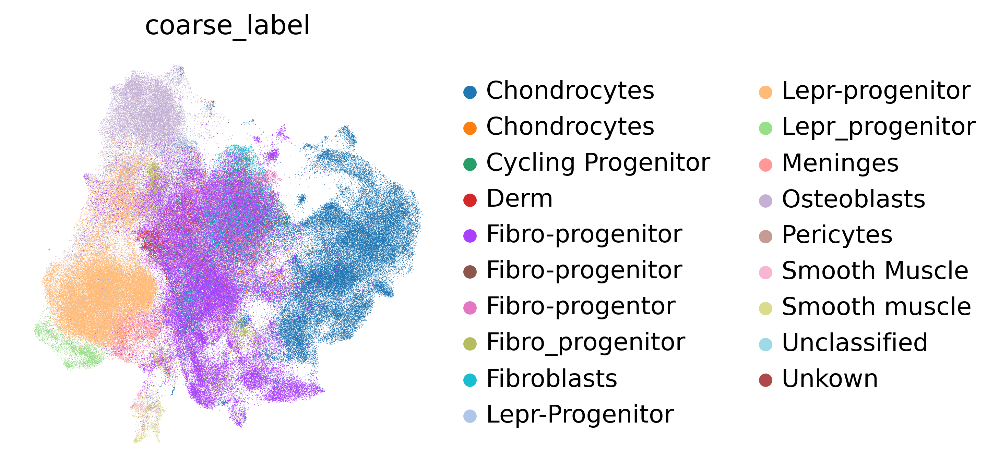

In [60]:
sc.pp.neighbors(reference_latent, n_neighbors=8)
sc.tl.leiden(reference_latent)
sc.tl.umap(reference_latent)
sc.pl.umap(reference_latent,
           color=['coarse_label'],
           frameon=False,
           wspace=0.6,
           )

In [61]:
reference_latent.write_h5ad("../../important_processed_data/4.17_wt_integrate_1500_15_ref.h5ad")

In [ ]:
adata=sc.read("../../important_processed_data/4.12_wt_integrate_SCRAN_log1p.h5ad")

In [63]:
adata=adata[index_arr,]

In [68]:
reference_latent.X.shape

(273479, 15)

In [69]:
del adata.obsm

In [70]:
adata.obsm["X_scANVI"]=reference_latent.X

In [71]:
adata.obsm["X_umap"]=reference_latent.obsm["X_umap"]

In [79]:
adata.obs["coarse_label"]

Suture2021_Farmer_E17_AAACCTGCAGACTCGC-1_1-0         Osteoblasts
Suture2021_Farmer_E17_AAACCTGGTGCGGTAA-1_1-0    Fibro-progenitor
Suture2021_Farmer_E17_AAACCTGGTGGTCTCG-1_1-0         Osteoblasts
Suture2021_Farmer_E17_AAACCTGTCACCACCT-1_1-0         Osteoblasts
Suture2021_Farmer_E17_AAACCTGTCGTTACGA-1_1-0    Fibro-progenitor
                                                      ...       
TTTGACTGTATTTCCT-1_5-1-2                        Fibro-progenitor
TTTGACTGTTGCATTG-1_5-1-2                        Fibro-progenitor
TTTGACTTCTTGGGCG-1_5-1-2                            Chondrocytes
TTTGGAGCAGCGACAA-1_5-1-2                             Osteoblasts
TTTGGTTCACTACTTT-1_5-1-2                             Osteoblasts
Name: coarse_label, Length: 273479, dtype: category
Categories (19, object): ['Chondrocytes', 'Chondrocytes ', 'Cycling Progenitor', 'Derm', ..., 'Smooth Muscle', 'Smooth muscle', 'Unclassified', 'Unkown']

In [97]:
adata.obs["coarse_label"]=adata.obs["coarse_label"].replace(["Chondrocytes "],"Chondrocytes").replace(["Fibro_progenitor","Fibro-progentor","Fibro-progenitor "],"Fibro-progenitor").replace(["Lepr_progenitor","Lepr-Progenitor"],"Lepr-progenitor").replace(["Smooth Muscle","Pericytes"],"Smooth muscle").replace("Unkown","Unclassified")

In [74]:
adata.obs["coarse_label"].cat()

TypeError: 'CategoricalAccessor' object is not callable

In [142]:
adata

AnnData object with n_obs × n_vars = 273479 × 62934
    obs: 'orig.ident', 'nCount_originalexp', 'nFeature_originalexp', 'Sample', 'Project', 'Limb.Atlas', 'Organ', 'Tissue', 'Tissue.Specific.', 'Stage', 'Gene.type', 'Treatment', 'Age', 'Age.In.Detail.', 'Machine', 'Species', 'Isolation.approach', 'Digestion', 'Enzymes', 'Cre', 'Bone.Forming.Methods', 'Data.Source', 'Related.Assay', 'Origin', 'nCount_RNA', 'nFeature_RNA', 'paper_label', 'coarse_label', 'scDblFinder_class', 'short_id', 'temp_cluster', 'batch', 'K2', 'K6', 'K12', 'K24', 'K53', 'K2.1', 'K6.1', 'K12.1', 'K24.1', 'K53.1', 'K2.2', 'K6.2', 'K12.2', 'K24.2', 'K53.2', 'K2.3', 'K6.3', 'K12.3', 'K24.3', 'K53.3', 'C2', 'C6', 'C12', 'C21', 'C41', 'C2_named', 'C6_named', 'C12_named', 'C21_named', 'C41_named', 'K4', 'K11', 'K25', 'K57', 'C4', 'C9', 'C22', 'C42', 'C4_named', 'C9_named', 'C22_named', 'C42_named', 'K5', 'K19', 'K65', 'C17', 'C36', 'C5', 'C5_named', 'C17_named', 'C36_named', 'batch_atlas', 'size_factors', 'n_genes_by_cou

/home/gilberthan/anaconda3/envs/scarches/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


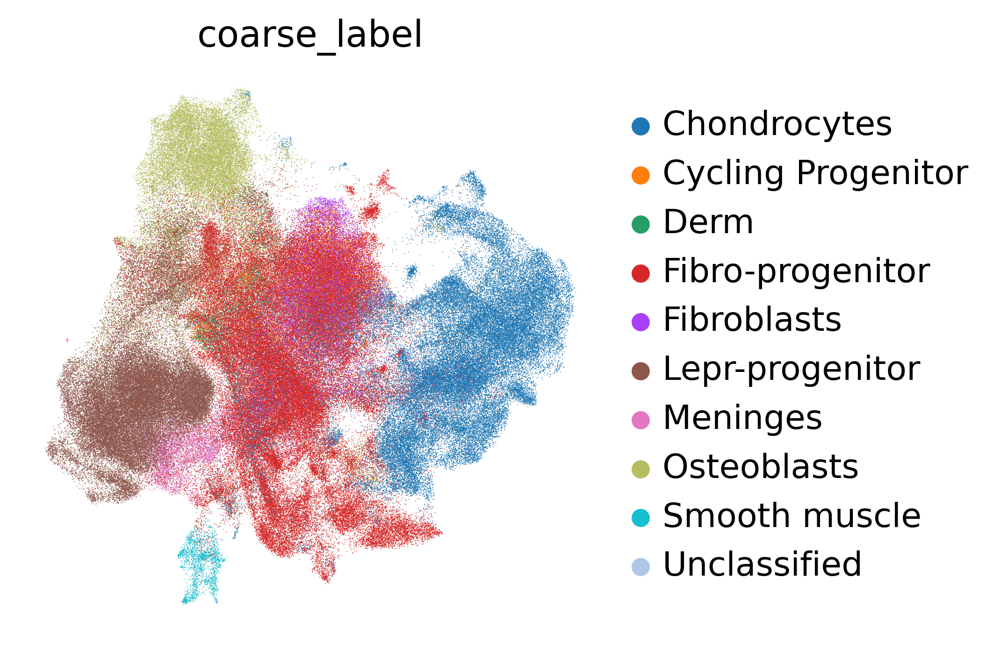

In [99]:
sc.pl.umap(adata,
           color=['coarse_label'],
           frameon=False,
           wspace=0.6,
           )

In [105]:
adata.X.max()

11.288712

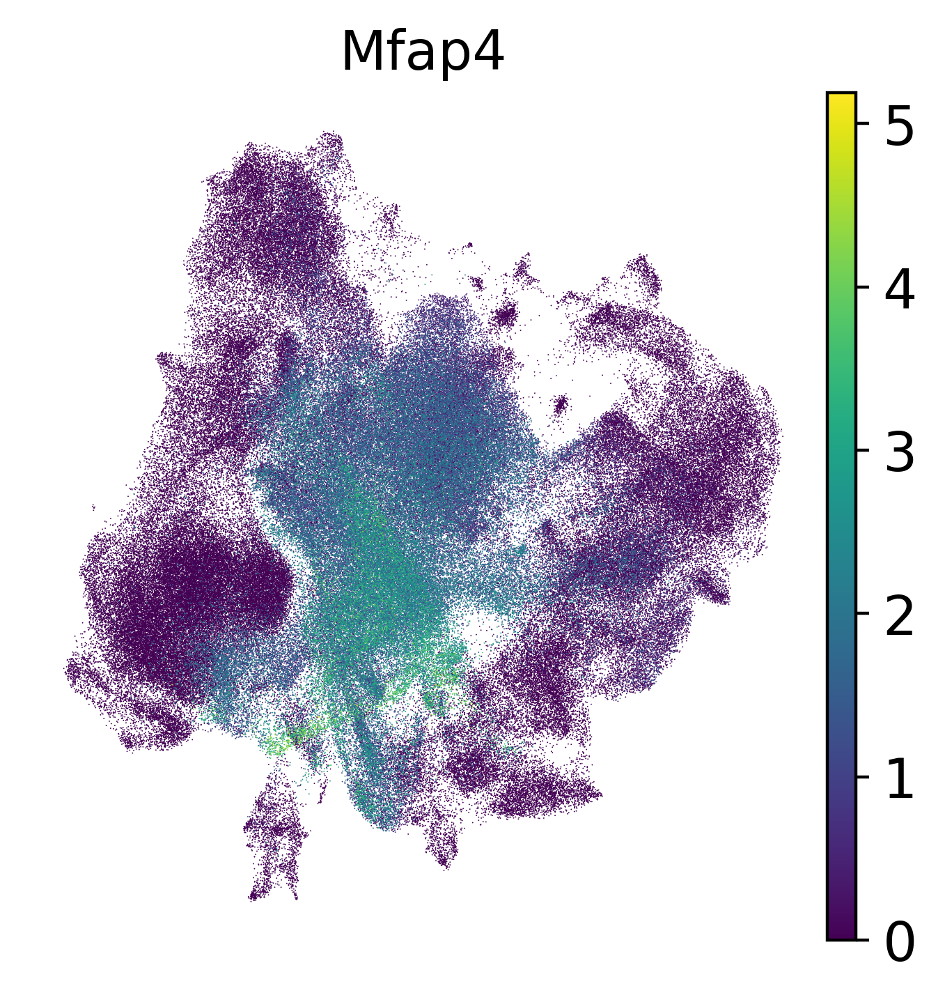

In [106]:
sc.pl.umap(adata,
           color=['Mfap4'],
           frameon=False,
           wspace=0.6,use_raw=False
           )

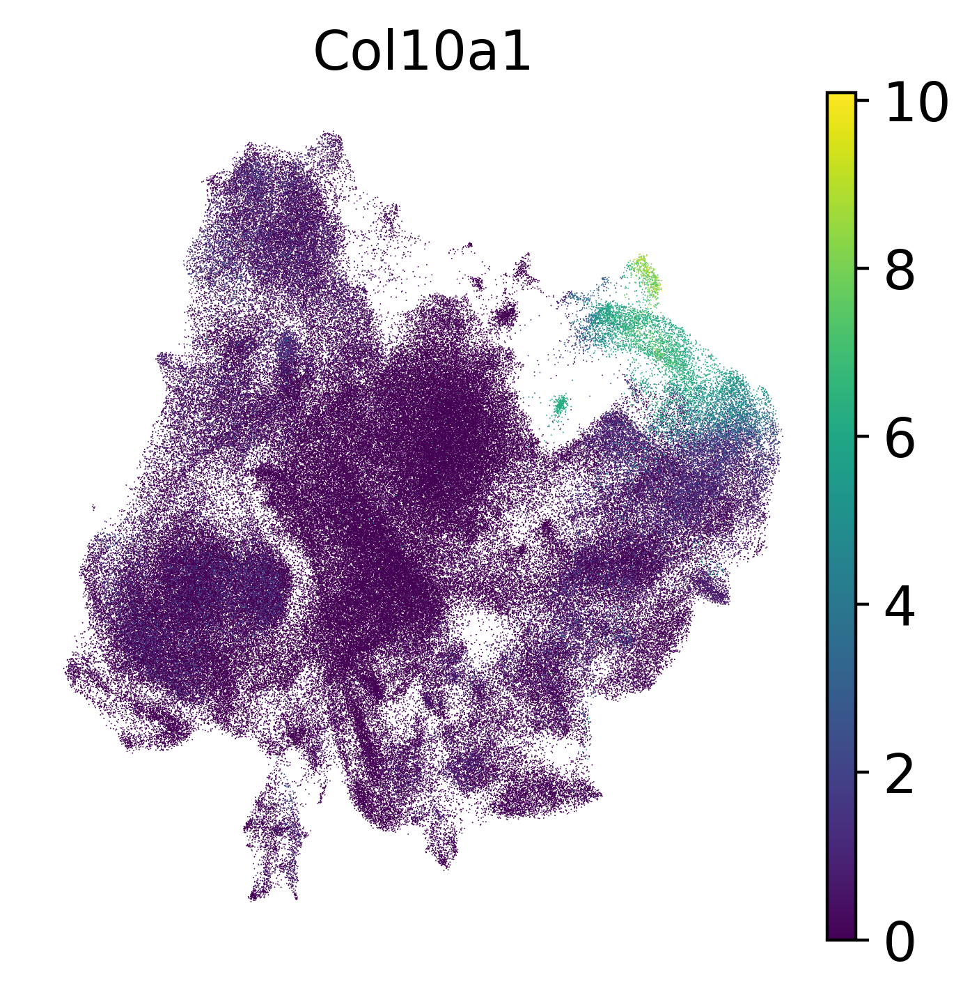

In [108]:
sc.pl.umap(adata,
           color=['Col10a1'],
           frameon=False,
           wspace=0.6,use_raw=False
           )

In [143]:
adata.write_h5ad("../../important_processed_data/4.17_wt_integrate_SCRAN_log1p_scANVI.h5ad")

In [110]:
adata.obs["batch_atlas"]

,orig.ident,nCount_originalexp,nFeature_originalexp,Sample,Project,Limb.Atlas,Organ,Tissue,Tissue.Specific.,Stage,...,size_factors,n_genes_by_counts,log1p_n_genes_by_counts,total_counts,log1p_total_counts,pct_counts_in_top_50_genes,pct_counts_in_top_100_genes,pct_counts_in_top_200_genes,pct_counts_in_top_500_genes,new_totals_log
Suture2021_Farmer_E17_AAACCTGCAGACTCGC-1_1-0,Suture2021_Farmer_E17,11668.0,3222,Suture2021_Farmer_E17,Suture2021_Farmer,False,Head,Suture mesenchyme,Coronal suture,Development,...,1.005194,3222,8.078068,11607.707031,9.359510,27.511066,41.052335,52.331015,66.240824,4.064746
Suture2021_Farmer_E17_AAACCTGGTGCGGTAA-1_1-0,Suture2021_Farmer_E17,14744.0,3910,Suture2021_Farmer_E17,Suture2021_Farmer,False,Head,Suture mesenchyme,Coronal suture,Development,...,1.395756,3910,8.271548,10563.455078,9.265250,21.791587,34.121840,45.889168,61.122251,4.023806
Suture2021_Farmer_E17_AAACCTGGTGGTCTCG-1_1-0,Suture2021_Farmer_E17,14962.0,3533,Suture2021_Farmer_E17,Suture2021_Farmer,False,Head,Suture mesenchyme,Coronal suture,Development,...,1.243669,3533,8.170186,12030.528320,9.395286,26.313787,39.280199,51.431182,66.603245,4.080285
Suture2021_Farmer_E17_AAACCTGTCACCACCT-1_1-0,Suture2021_Farmer_E17,14473.0,3565,Suture2021_Farmer_E17,Suture2021_Farmer,False,Head,Suture mesenchyme,Coronal suture,Development,...,1.271300,3565,8.179200,11384.409180,9.340088,28.453518,39.197861,50.923361,66.055296,4.056311
Suture2021_Farmer_E17_AAACCTGTCGTTACGA-1_1-0,Suture2021_Farmer_E17,14249.0,3968,Suture2021_Farmer_E17,Suture2021_Farmer,False,Head,Suture mesenchyme,Coronal suture,Development,...,1.451486,3968,8.286269,9816.837891,9.191957,20.991325,31.223809,43.386274,59.380631,3.991972
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
TTTGACTGTATTTCCT-1_5-1-2,Metaphysis_Yang_sorted,11255.0,3122,Metaphysis_Yang_sorted,Metaphysis_Yang,True,Limb,Femur;Tibia,Metaphysis,Development,...,1.017997,3122,8.046549,11056.024414,9.310822,44.397362,49.852630,56.889393,68.226428,4.043599
TTTGACTGTTGCATTG-1_5-1-2,Metaphysis_Yang_sorted,2748.0,1298,Metaphysis_Yang_sorted,Metaphysis_Yang,True,Limb,Femur;Tibia,Metaphysis,Development,...,0.295148,1298,7.169350,9310.576172,9.139013,29.548754,40.720509,52.474504,70.960705,3.968976
TTTGACTTCTTGGGCG-1_5-1-2,Metaphysis_Yang_sorted,18312.0,4340,Metaphysis_Yang_sorted,Metaphysis_Yang,True,Limb,Femur;Tibia,Metaphysis,Development,...,1.836937,4340,8.375860,9968.770508,9.207313,37.298061,45.489435,53.702654,65.186953,3.998641
TTTGGAGCAGCGACAA-1_5-1-2,Metaphysis_Yang_sorted,70471.0,6264,Metaphysis_Yang_sorted,Metaphysis_Yang,True,Limb,Femur;Tibia,Metaphysis,Development,...,4.080801,6264,8.742734,17268.912109,9.756721,45.623703,55.069995,64.292079,74.696194,4.237265


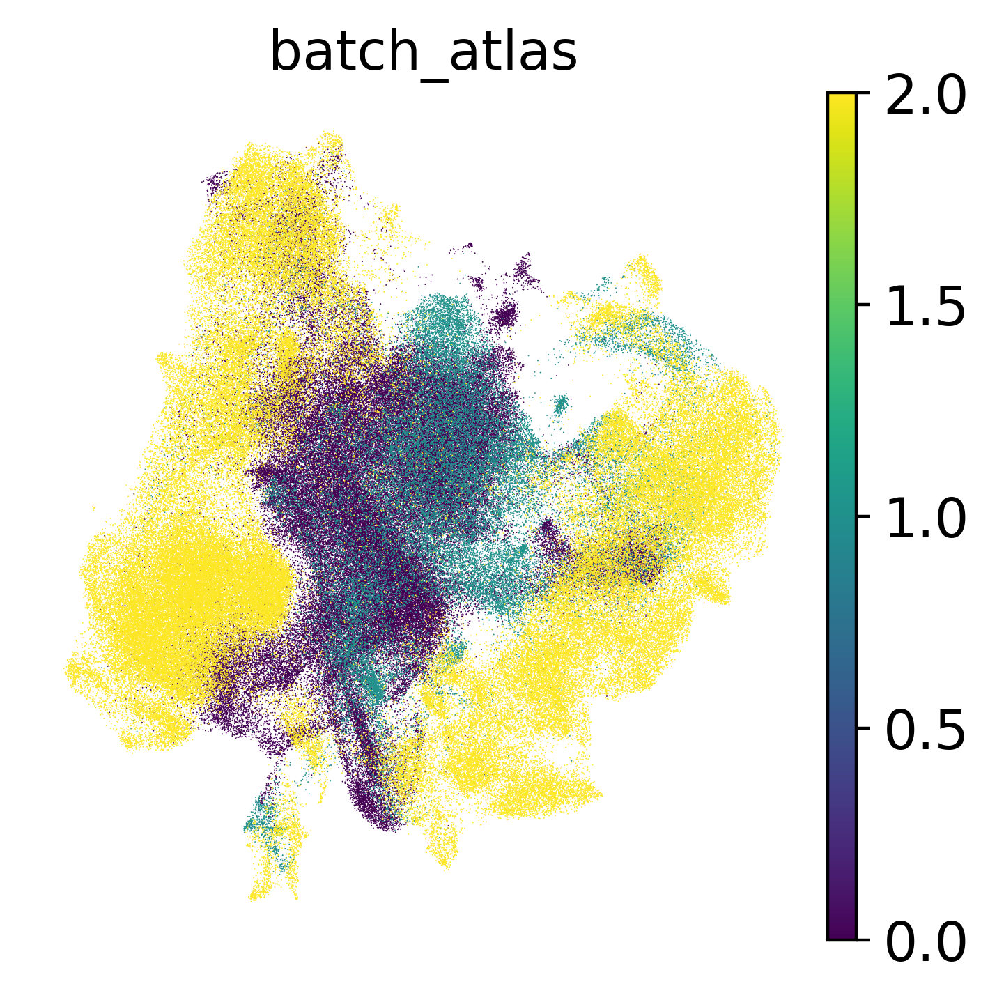

In [112]:
sc.pl.umap(adata,
           color=["batch_atlas"],
           frameon=False,
           wspace=0.6,use_raw=False
           )

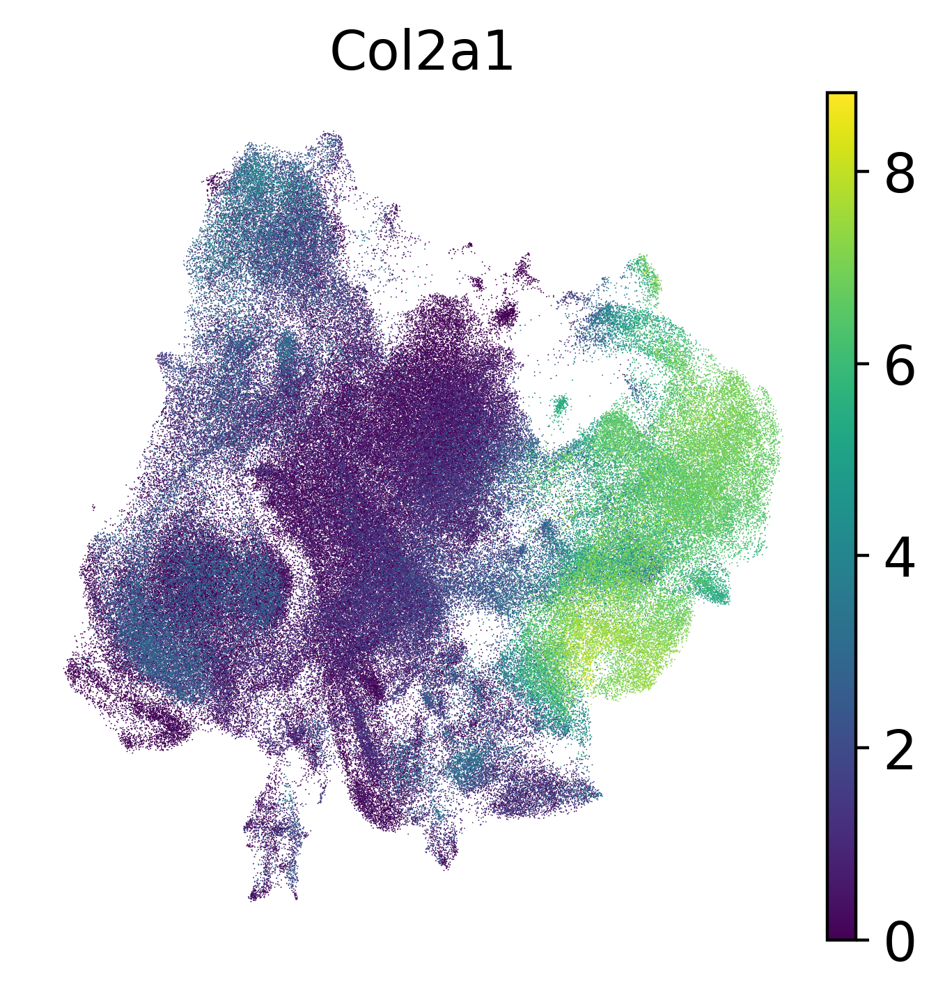

In [114]:
sc.pl.umap(adata,
           color=["Col2a1"],
           frameon=False,
           wspace=0.6,use_raw=False
           )

In [ ]:
sc.tl.draw_graph(reference_latent)


/home/gilberthan/anaconda3/envs/scarches/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


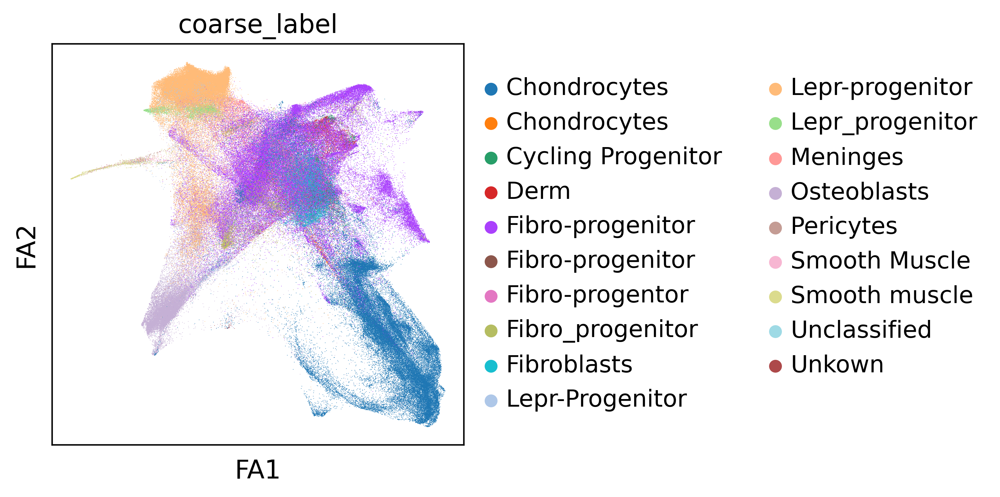

In [116]:

sc.pl.draw_graph(reference_latent, color='coarse_label')

In [117]:
adata.obsm["X_draw_graph_fa"]=reference_latent.obsm["X_draw_graph_fa"]

In [121]:
adata.obsp=reference_latent.obsp

In [124]:
adata.uns["draw_graph"]=reference_latent.uns["draw_graph"]

In [119]:
reference_latent

AnnData object with n_obs × n_vars = 273479 × 15
    obs: 'cell_type', 'coarse_label', 'Project', 'batch', 'leiden'
    uns: 'neighbors', 'leiden', 'umap', 'coarse_label_colors', 'draw_graph'
    obsm: 'X_umap', 'X_draw_graph_fa'
    obsp: 'distances', 'connectivities'

/home/gilberthan/anaconda3/envs/scarches/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


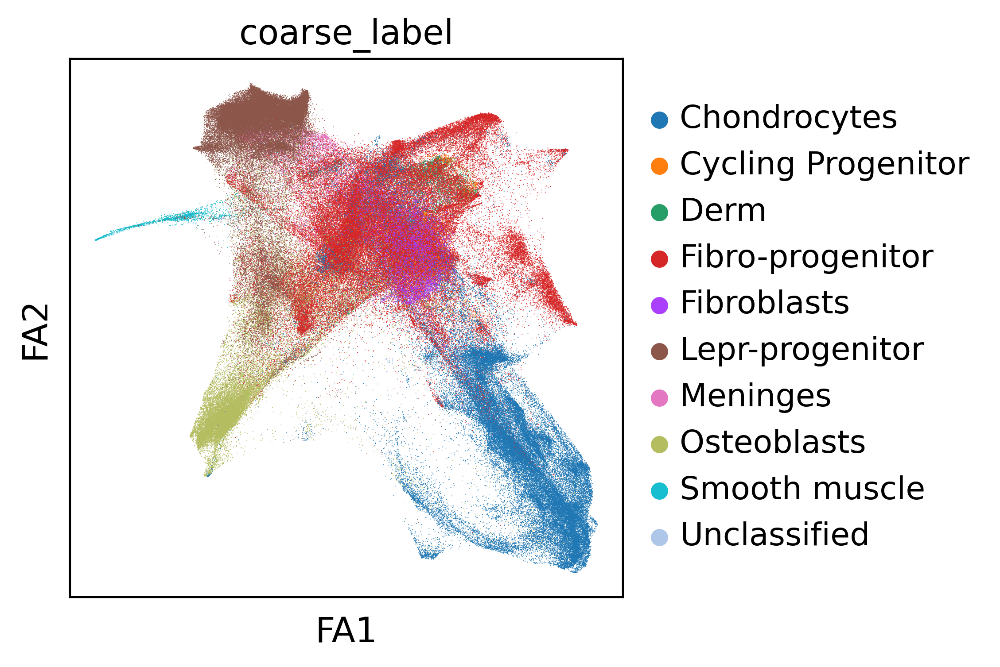

In [125]:
sc.pl.draw_graph(adata, color='coarse_label')

In [126]:
sc.tl.diffmap(reference_latent)
sc.pp.neighbors(reference_latent, n_neighbors=10, use_rep='X_diffmap')

In [127]:
sc.tl.draw_graph(reference_latent)

/home/gilberthan/anaconda3/envs/scarches/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


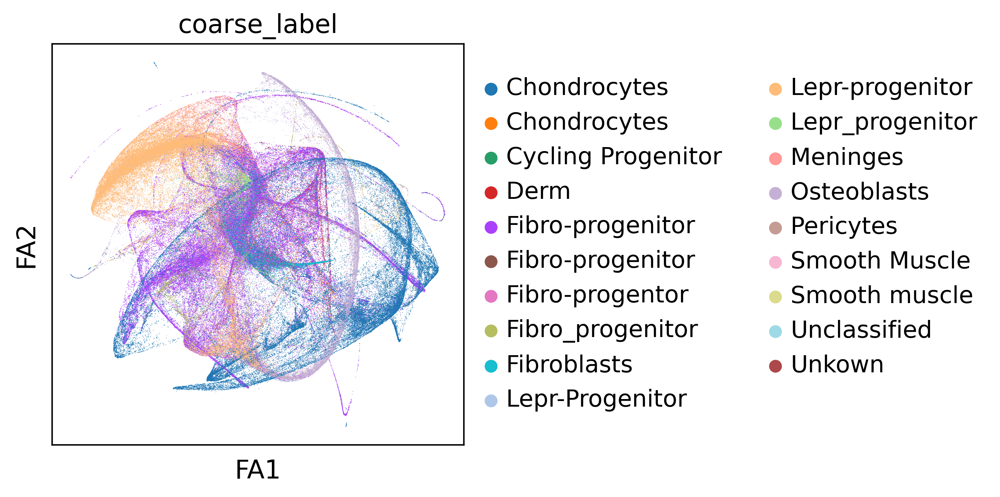

In [128]:
sc.pl.draw_graph(reference_latent,color="coarse_label")

In [129]:
reference_latent

AnnData object with n_obs × n_vars = 273479 × 15
    obs: 'cell_type', 'coarse_label', 'Project', 'batch', 'leiden'
    uns: 'neighbors', 'leiden', 'umap', 'coarse_label_colors', 'draw_graph', 'diffmap_evals'
    obsm: 'X_umap', 'X_draw_graph_fa', 'X_diffmap'
    obsp: 'distances', 'connectivities'

In [131]:
dist_matrix = pd.DataFrame(sc.get.obs_df(reference_latent, keys=['leiden']), columns=['Cluster'])

In [133]:
dist_matrix['Coordinates'] = list(reference_latent.obsm['X_umap'])

/home/gilberthan/anaconda3/envs/scarches/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


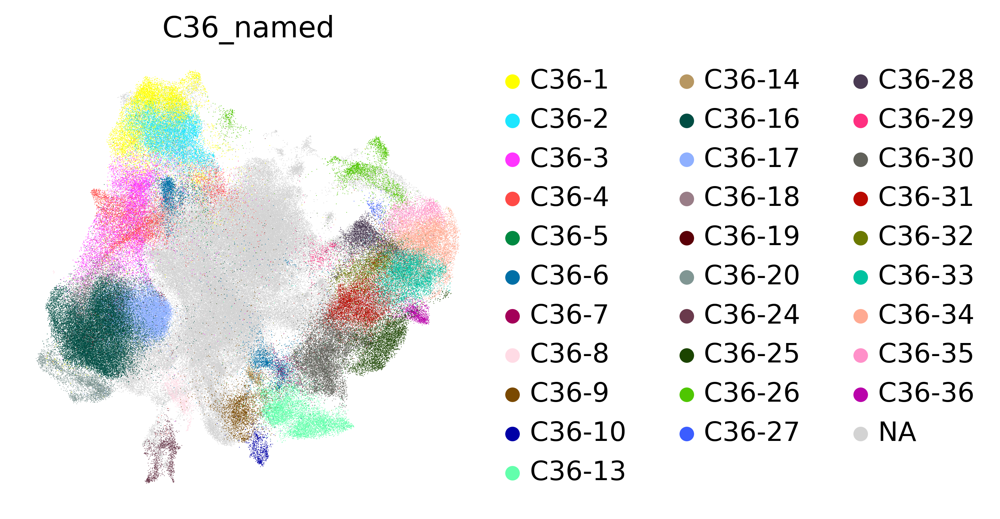

In [146]:
sc.pl.umap(adata,
           color=["C36_named"],
           frameon=False,
           wspace=0.6,use_raw=False
           )

In [147]:
reference_latent.obs=adata.obs

In [148]:
reference_latent.write_h5ad("../../important_processed_data/4.17_wt_integrate_1500_15_ref.h5ad")